# Growth Mechanism with Details

In [101]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

import sys
import numpy as np
import os
import matplotlib.pyplot as plt
from matplotlib import gridspec
from matplotlib import colors

sys.path.append('../../src')
from m3_learning.nn.random import random_seed
from m3_learning.viz.style import set_style
from m3_learning.viz.printing import printer
from m3_learning.viz.layout import imagemap, layout_fig, labelfigs
from m3_learning.RHEED.Dataset import RHEED_parameter_dataset, RHEED_spot_Dataset
from m3_learning.RHEED.Viz import Viz
from m3_learning.RHEED.Analysis import detect_peaks, analyze_curves, process_rheed_data 
from m3_learning.RHEED.Packed_functions import decay_curve_examples
from m3_learning.RHEED.Analysis_umich import fit_curves, analyze_rheed_data, analyze_txt_rheed, select_range

plot_size = (6, 2)
color_blue = (44/255,123/255,182/255)
color_gray = (128/255, 128/255, 128/255, 0.5)
seq_colors = ['#00429d','#2e59a8','#4771b2','#5d8abd','#73a2c6','#8abccf','#a5d5d8','#c5eddf','#ffffe0']
bgc1, bgc2 = (*colors.hex2color(seq_colors[0]), 0.3), (*colors.hex2color(seq_colors[5]), 0.3)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## 1. Visualize the spots from collected data

In [220]:
para_path = 'F:/UMich/J14_PM04_05_06_gaussian_fit_parameters_08252023.h5'
ds_para = RHEED_parameter_dataset(spot_ds_path, camera_freq=2000, sample_name='J14')
ds_para.data_info

Growth: temp250:
--spot: spot_1:
----height:, Size of data: (499922,)
----img_max:, Size of data: (499922,)
----img_mean:, Size of data: (499922,)
----img_rec_max:, Size of data: (499922,)
----img_rec_mean:, Size of data: (499922,)
----img_rec_sum:, Size of data: (499922,)
----img_sum:, Size of data: (499922,)
----raw_image:, Size of data: (499922, 22, 10)
----reconstructed_image:, Size of data: (499922, 22, 10)
----width_x:, Size of data: (499922,)
----width_y:, Size of data: (499922,)
----x:, Size of data: (499922,)
----y:, Size of data: (499922,)
--spot: spot_2:
----height:, Size of data: (499922,)
----img_max:, Size of data: (499922,)
----img_mean:, Size of data: (499922,)
----img_rec_max:, Size of data: (499922,)
----img_rec_mean:, Size of data: (499922,)
----img_rec_sum:, Size of data: (499922,)
----img_sum:, Size of data: (499922,)
----raw_image:, Size of data: (499922, 29, 13)
----reconstructed_image:, Size of data: (499922, 29, 13)
----width_x:, Size of data: (499922,)
----wid

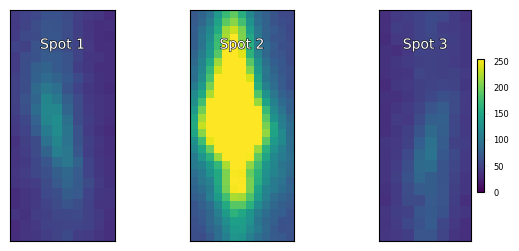

In [10]:
img_spot1 = ds_para.growth_dataset(growth='temp250', metric='raw_image', spot='spot_1', index=100)
img_spot2 = ds_para.growth_dataset(growth='temp250', metric='raw_image', spot='spot_2', index=100)
img_spot3 = ds_para.growth_dataset(growth='temp250', metric='raw_image', spot='spot_3', index=100)

imgs = [img_spot1, img_spot2, img_spot3]
width_ratios = [img.shape[1]/img.shape[0] for img in imgs]
titles = ['Spot 1', 'Spot 2', 'Spot 3']
fig = plt.figure(figsize=(6.5, 3))
gs = gridspec.GridSpec(nrows=1, ncols=3, width_ratios=width_ratios, wspace=0.1)
axes = [fig.add_subplot(gs[i]) for i in range(len(imgs))]
for i, ax in enumerate(axes):
    if i == 2:
        imagemap(ax, imgs[i], colorbars=True, clim=(0,255), divider_=False)
    else:
        imagemap(ax, imgs[i], colorbars=False, clim=(0,255), divider_=False)
    labelfigs(ax, None, string_add=titles[i], loc='ct', size=10)
plt.show()

## 2. Analyze the Decay Curve

### 2.1 J14-300C

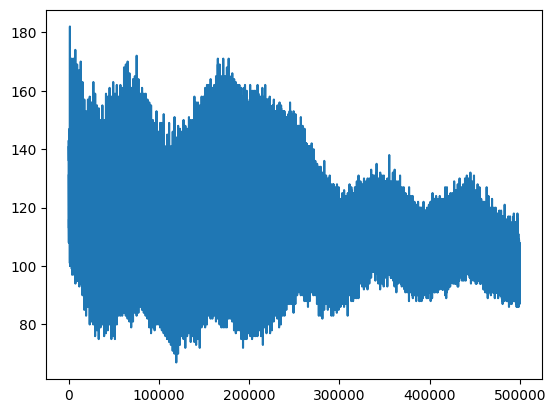

In [14]:
ds_max = ds_para.growth_dataset(growth='temp250', metric='img_max', spot='spot_1')
plt.
plt.plot(ds_max)

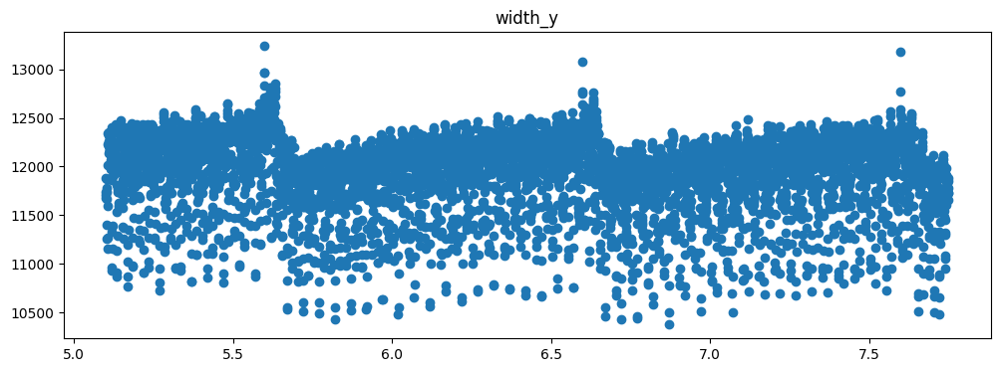

In [23]:
    x, y = ds_para.load_curve(growth='temp250', spot='spot_1', metric='img_sum', x_start=0)
    sample_x, sample_y = x[10200:15500], y[10200:15500]
    plt.figure(figsize=(12,4))
    plt.scatter(sample_x, sample_y)
    plt.title(m)
    plt.show()

In [117]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt

def denoise_fft(sample_x, sample_y, cutoff_freq, denoise_order, sample_frequency):

    nyquist = 0.5 * sample_frequency
    low = cutoff_freq / nyquist
    b, a = butter(denoise_order, low, btype='low')

    # Apply the low-pass filter to denoise the signal
    denoised_sample_y = filtfilt(b, a, sample_y)

    # Compute the frequency spectrum of the original and denoised signals
    freq = np.fft.rfftfreq(len(sample_x), d=1/sample_frequency)
    fft_original = np.abs(np.fft.rfft(sample_y))
    fft_denoised = np.abs(np.fft.rfft(denoised_sample_y))

    # Plot the original and denoised signals
    plt.figure(figsize=(8, 4))
    plt.subplot(2, 1, 1)
    plt.scatter(sample_x, sample_y, label='Original Signal')
    plt.plot(sample_x, denoised_sample_y, color='r', label='Denoised Signal')
    plt.legend()

    # Plot the frequency spectrum
    plt.subplot(2, 1, 2)
    plt.plot(freq, fft_original, label='Original Spectrum')
    plt.plot(freq, fft_denoised, label='Denoised Spectrum')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Amplitude')
    plt.legend()
    plt.grid()
    plt.yscale('log')
    
    plt.tight_layout()
    plt.show()

    return denoised_sample_y

from scipy.signal import medfilt
def denoise_median(sample_x, sample_y, kernel_size):

    # Apply median filtering with a window size of 3
    filtered_data = medfilt(sample_y, kernel_size=51)

    plt.figure(figsize=(8,2))
    plt.scatter(sample_x, sample_y, label='Original Signal')
    plt.plot(sample_x, filtered_data, color='r', label='Denoised Signal')
    plt.tight_layout()
    plt.show()
    return filtered_data

img_sum-spot_1


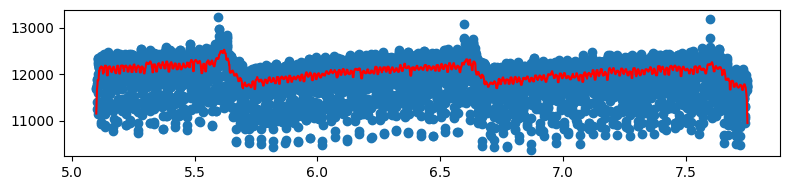

img_rec_sum-spot_1


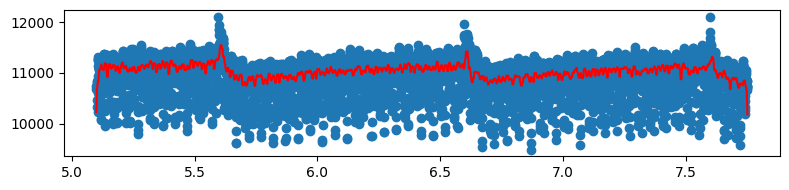

img_sum-spot_2


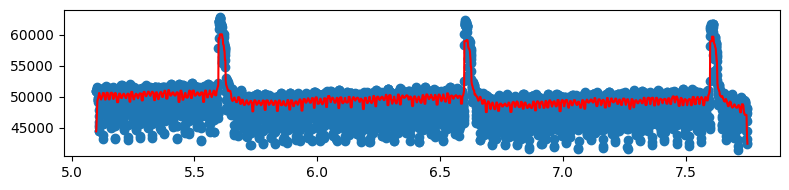

img_rec_sum-spot_2


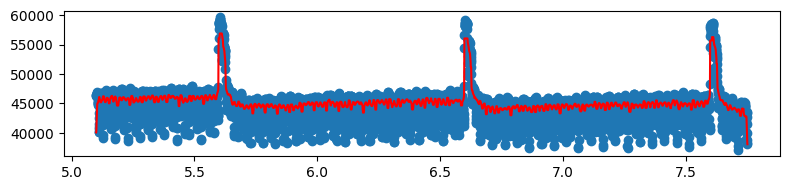

In [205]:
for spot in ['spot_1', 'spot_2']:
    for m in ["img_sum", "img_rec_sum"]:
        x, y = ds_para.load_curve(growth='temp250', spot=spot, metric=m, x_start=0)
        sample_x, sample_y = x[10200:15500], y[10200:15500]
        print(m+'-'+spot)
        
#         plt.figure(figsize=(8,2))
#         plt.scatter(sample_x, sample_y)
#         plt.title(m+'-'+spot)
#         plt.show()
        
#         denoised_sample_y = denoise_fft(sample_x, sample_y, cutoff_freq=10, denoise_order=3, sample_frequency=2000)
        denoised_sample_y = denoise_median(sample_x, sample_y, kernel_size=51)

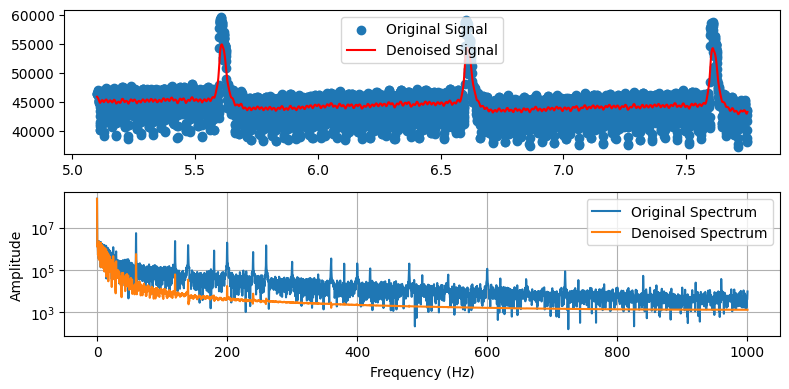

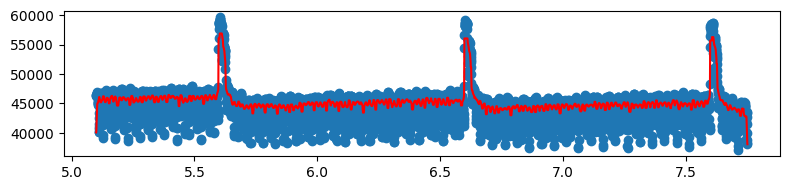

In [209]:
denoised_sample_y = denoise_fft(sample_x, sample_y, cutoff_freq=20, denoise_order=1, sample_frequency=2000)
denoised_sample_y = denoise_median(sample_x, sample_y, kernel_size=51)

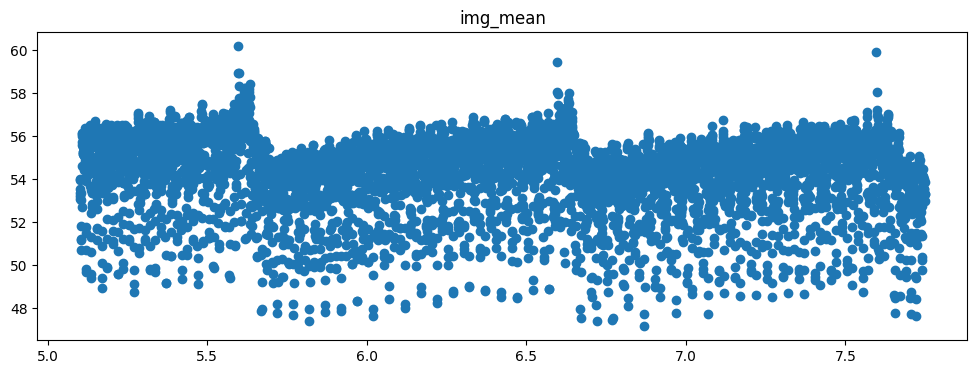

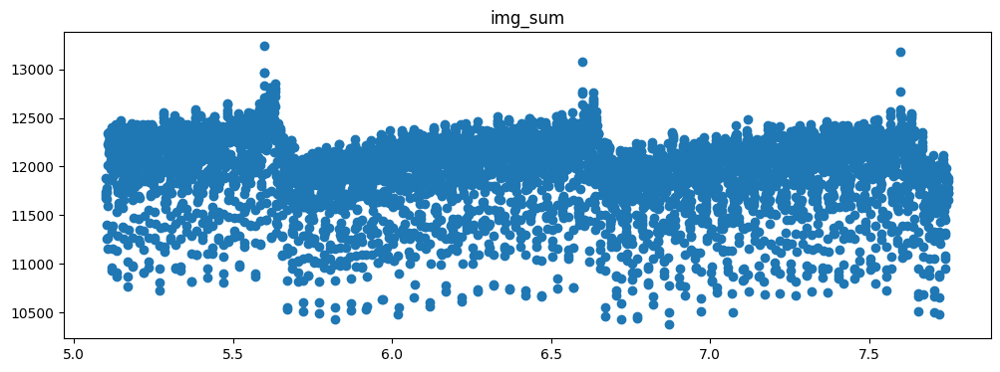

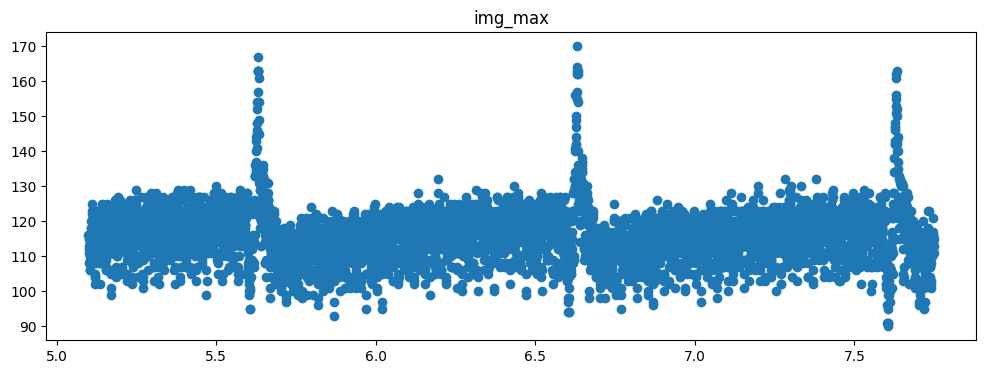

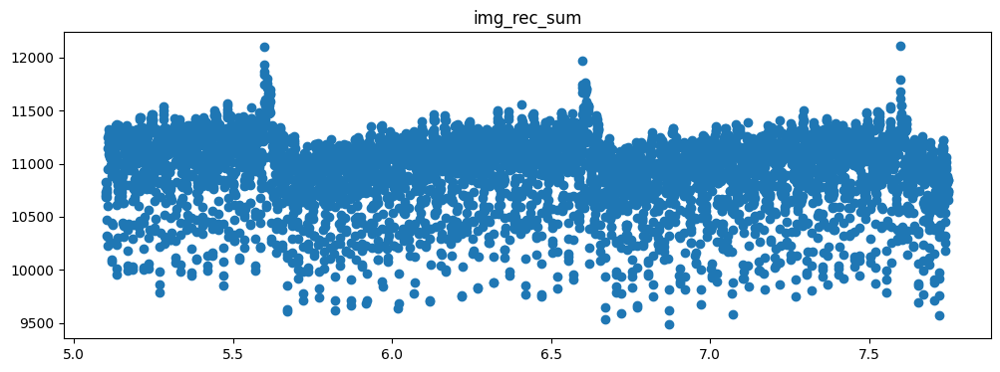

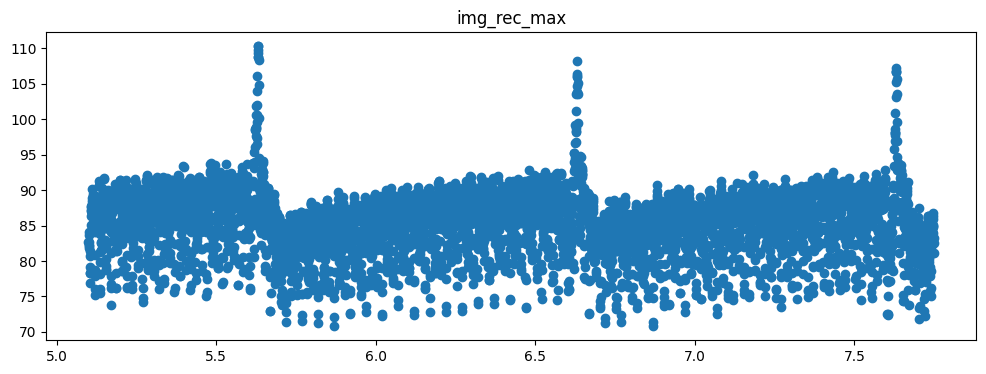

...

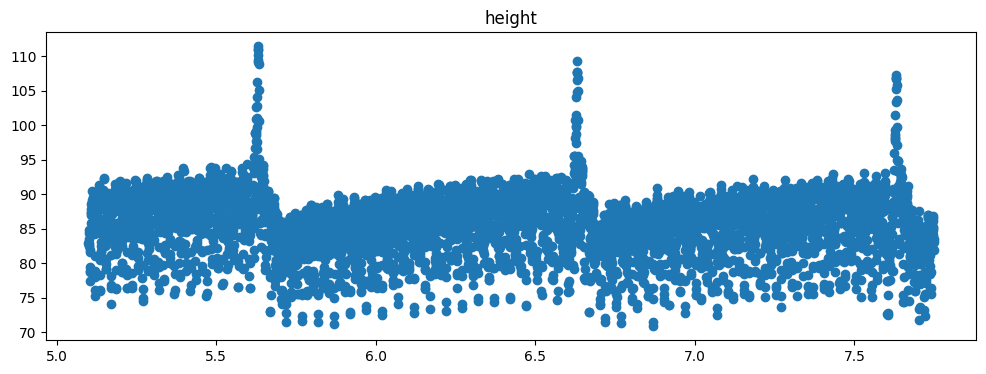

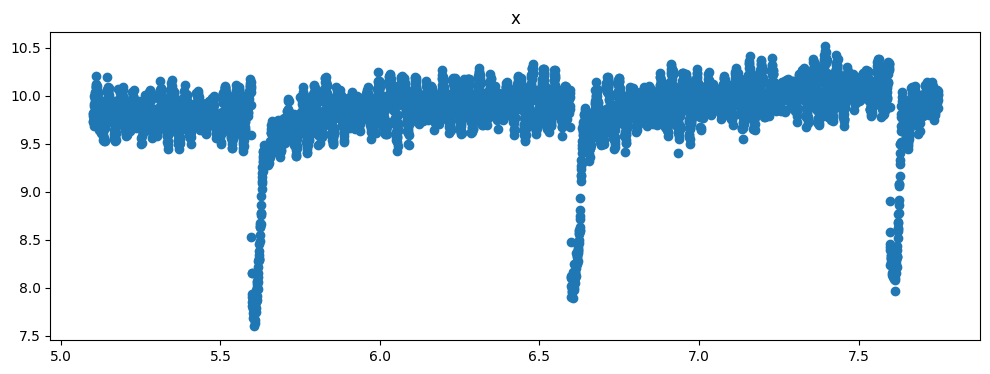

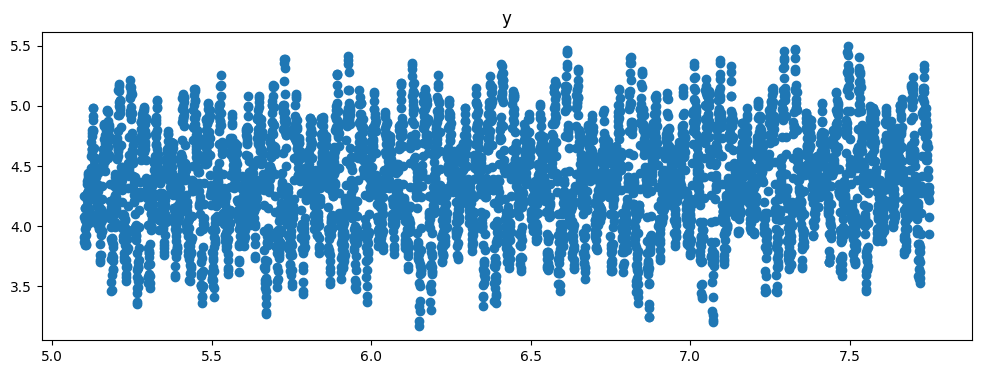

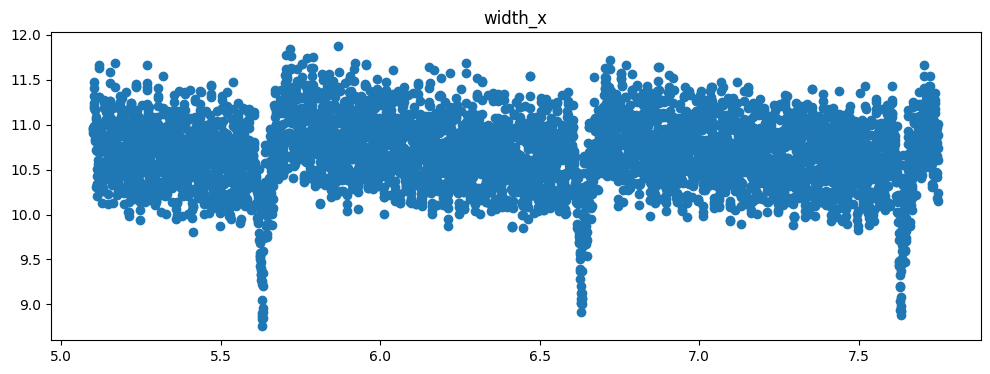

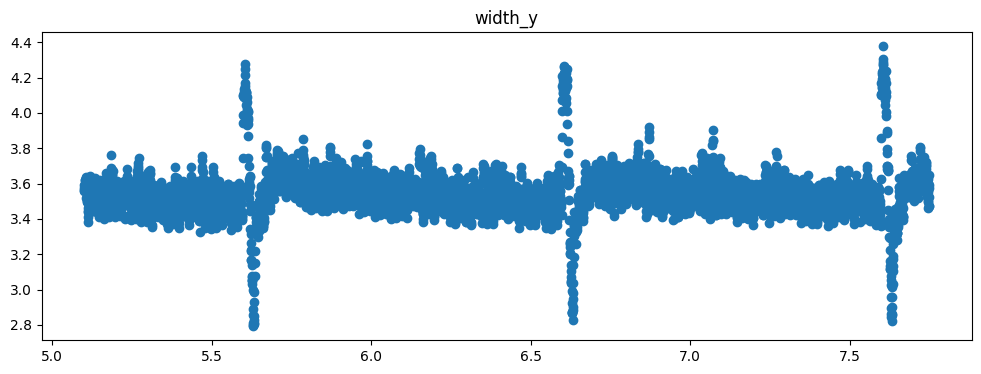

In [21]:
for m in ["img_mean", "img_sum", "img_max", "img_rec_sum", "img_rec_max", "img_rec_mean", 
          "height", "x", "y", "width_x", "width_y"]:
    x, y = ds_para.load_curve(growth='temp250', spot='spot_1', metric=m, x_start=0)
    sample_x, sample_y = x[10200:15500], y[10200:15500]
    plt.figure(figsize=(12,4))
    plt.scatter(sample_x, sample_y)
    plt.title(m)
    plt.show()

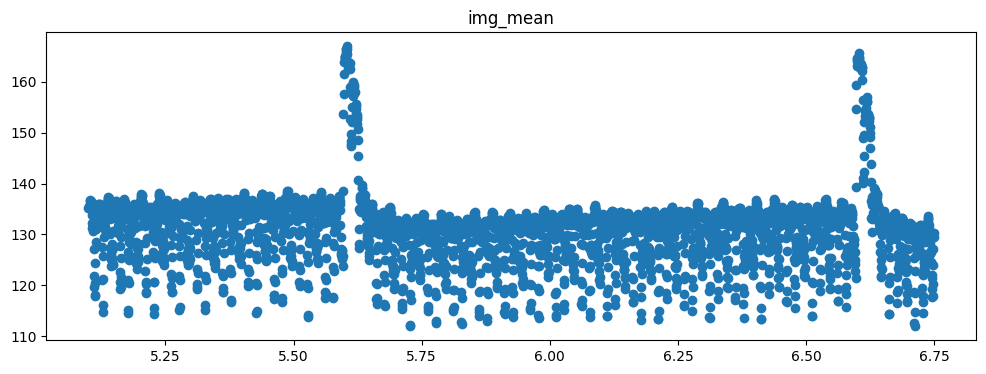

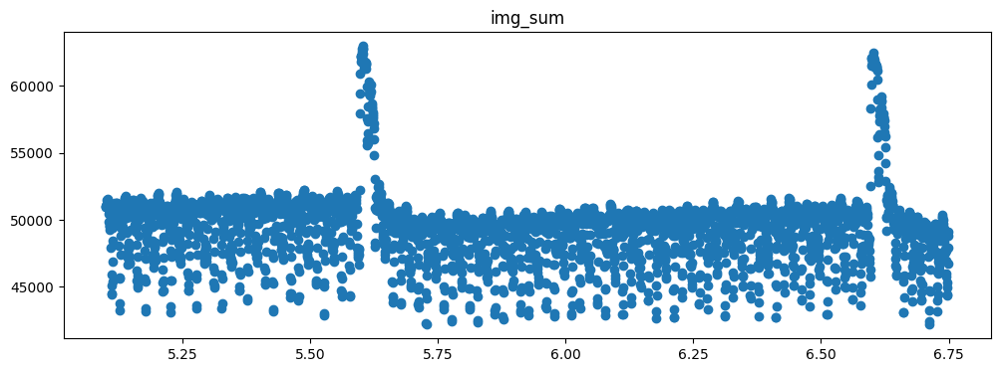

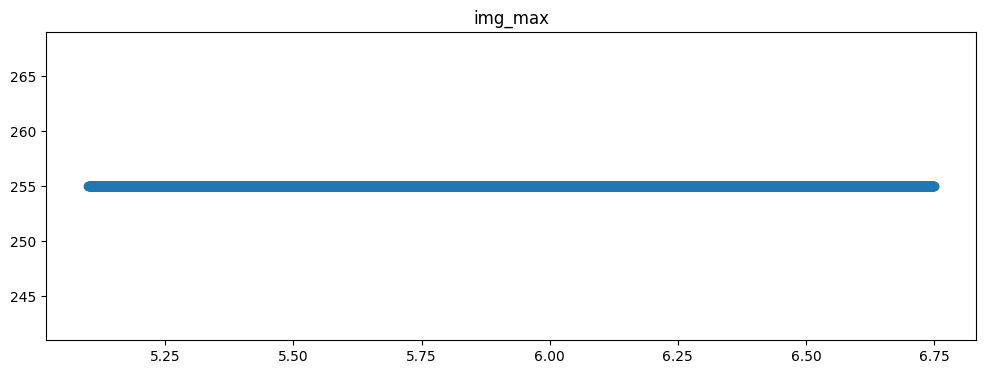

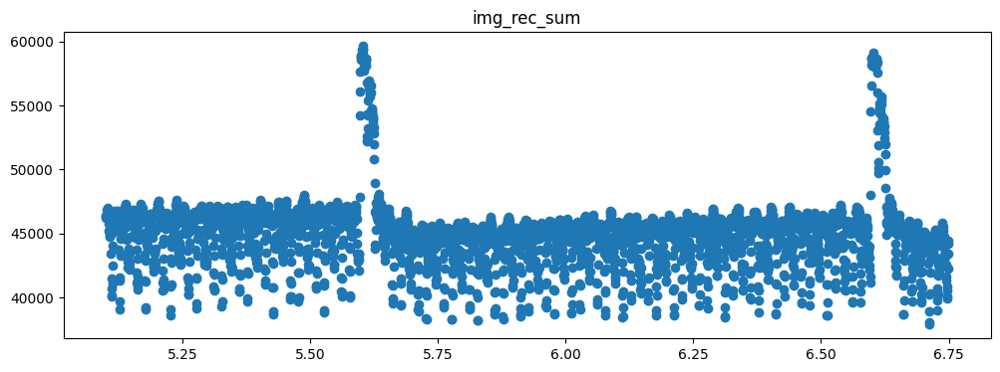

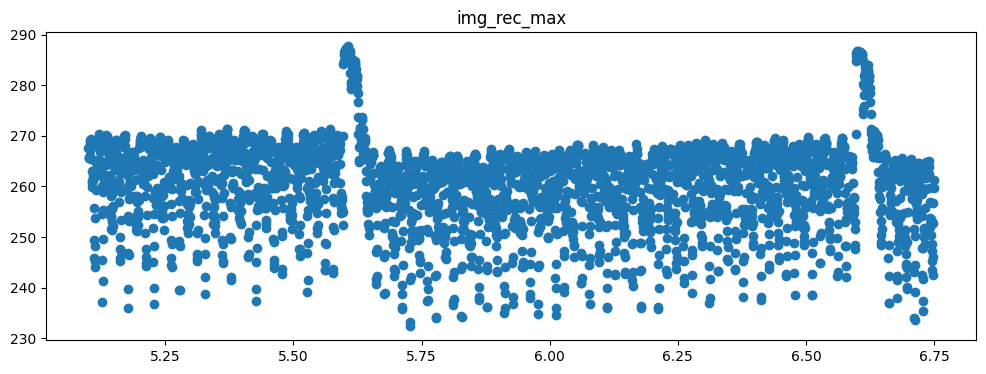

...

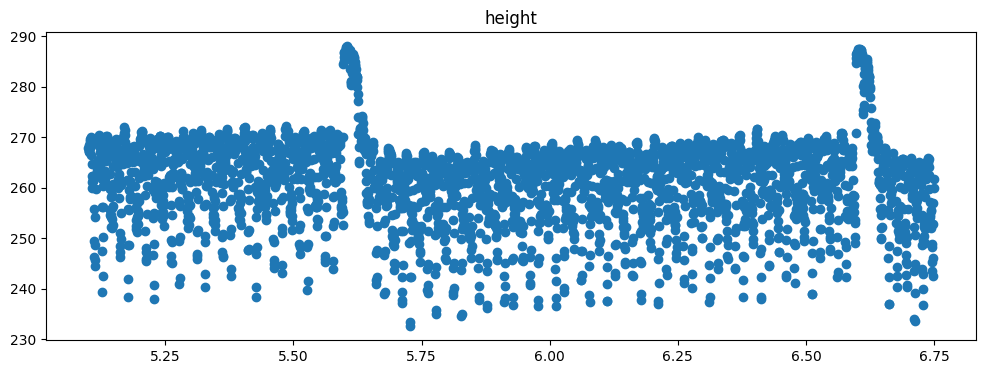

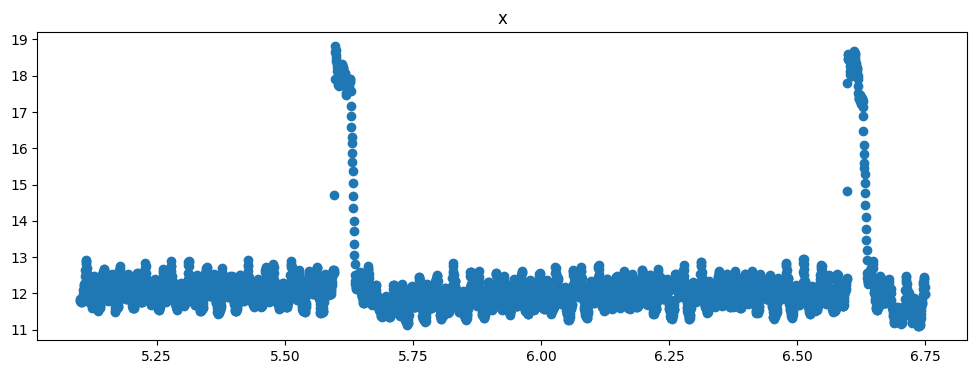

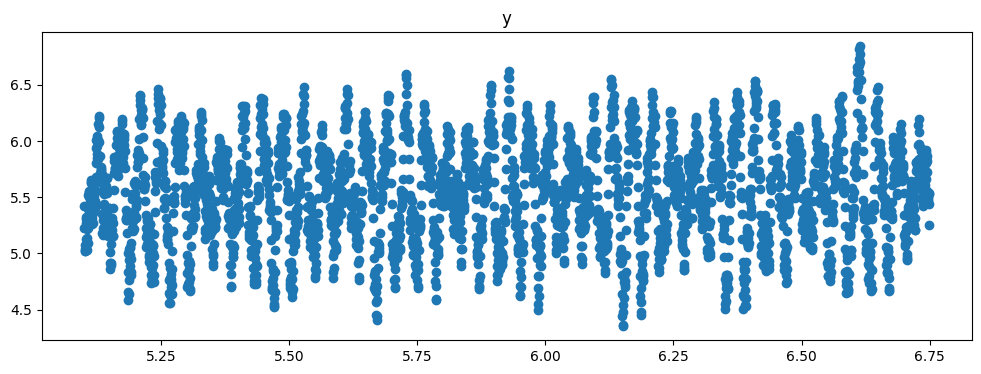

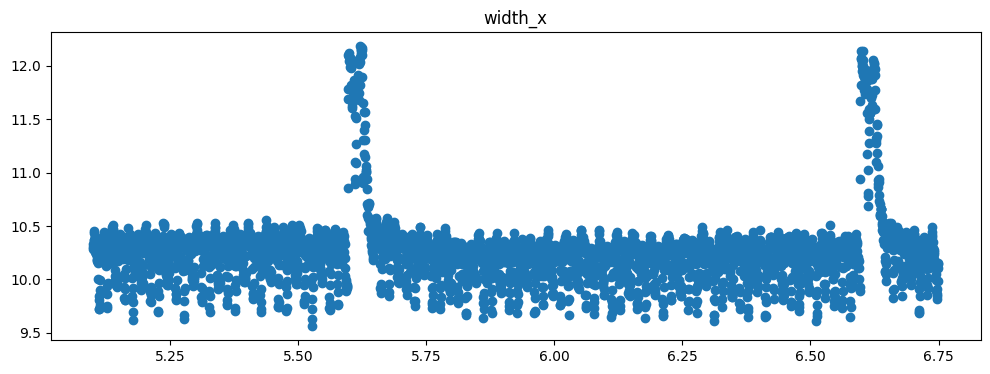

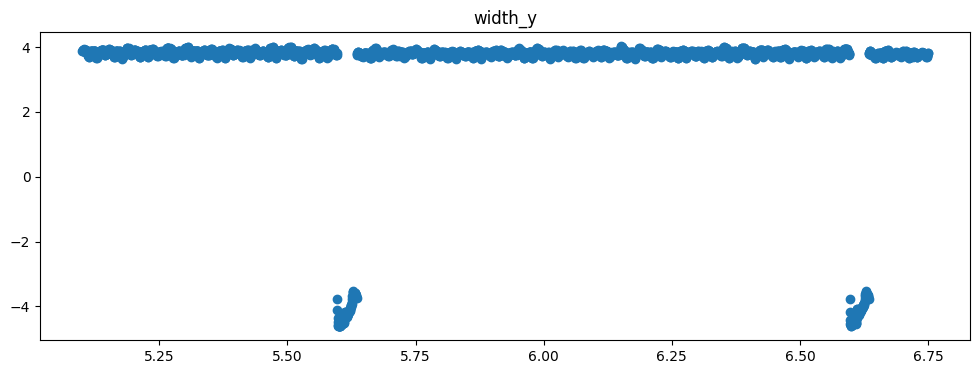

In [20]:
for m in ["img_mean", "img_sum", "img_max", "img_rec_sum", "img_rec_max", "img_rec_mean", 
          "height", "x", "y", "width_x", "width_y"]:
    x, y = ds_para.load_curve(growth='temp250', spot='spot_2', metric=m, x_start=0)
    sample_x, sample_y = x[10200:13500], y[10200:13500]
    plt.figure(figsize=(12,4))
    plt.scatter(sample_x, sample_y)
    plt.title(m)
    plt.show()

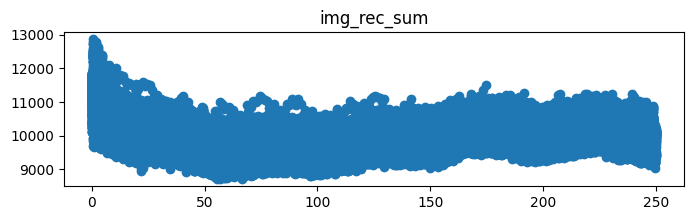

In [213]:
sample_x, sample_y = ds_para.load_curve(growth='temp250', spot='spot_1', metric='img_rec_sum', x_start=0)
plt.figure(figsize=(8,2))
plt.scatter(sample_x, sample_y)
plt.title('img_rec_sum')
plt.show()
# denoised_sample_y = denoise_median(sample_x, sample_y, kernel_size=101)

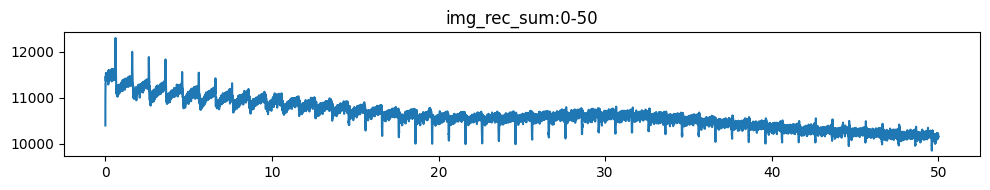

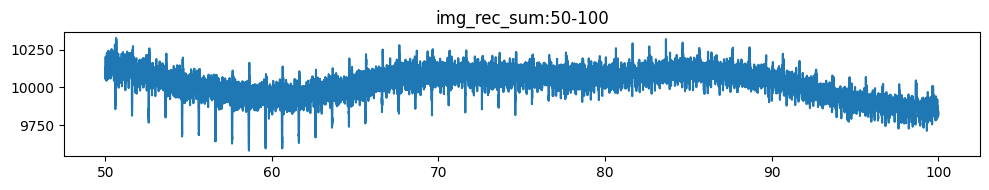

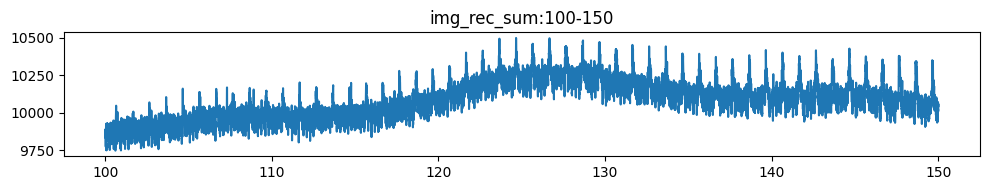

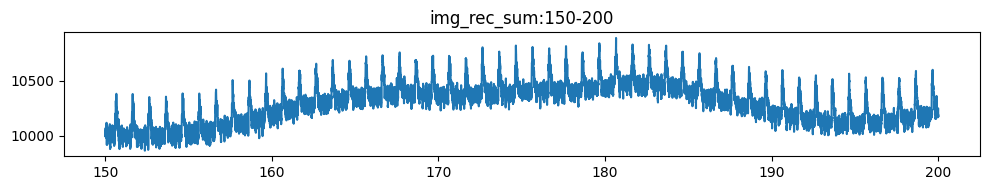

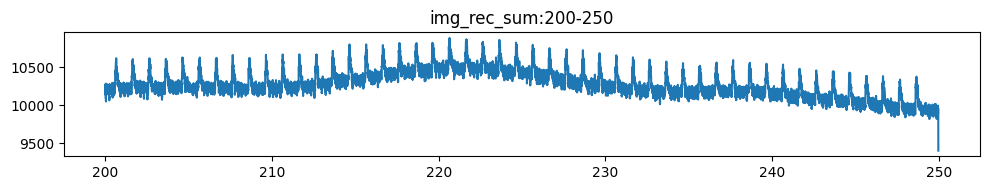

In [165]:
for start in range(0, int(np.max(sample_x))+1, 50):

    data = np.stack([sample_x, denoised_sample_y], 1)
    data = select_range(data, start, start+50)

    x_part, y_part = data[:,0], data[:,1]
    plt.figure(figsize=(10,2))
    plt.plot(x_part, y_part)
    plt.title('img_rec_sum' + ':' + str(start) + '-' + str(start+50))
    plt.tight_layout()
    plt.show()

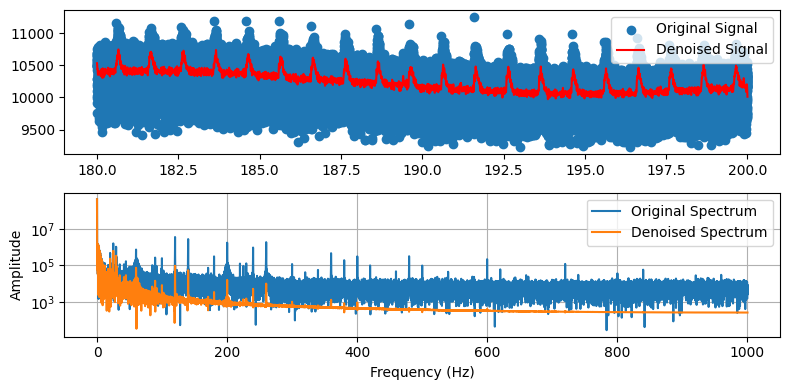

I:\RHEED_data\m3_learning\m3_learning\papers\2023_RHEED_PLD_SrTiO3 - UMich\../../src\m3_learning\RHEED\Viz.py:444: UserWarning: The figure layout has changed to tight
  plt.tight_layout(pad=-0.5, w_pad=-1, h_pad=-0.5)


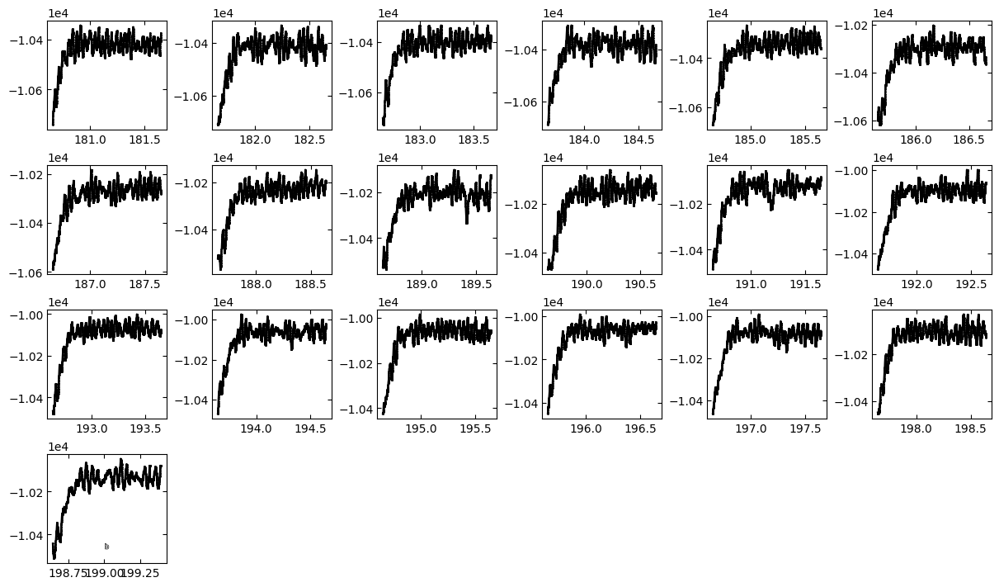

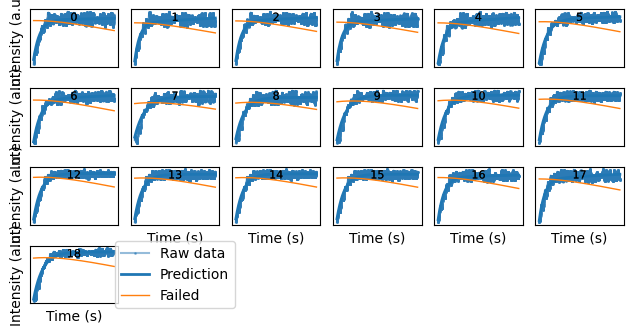

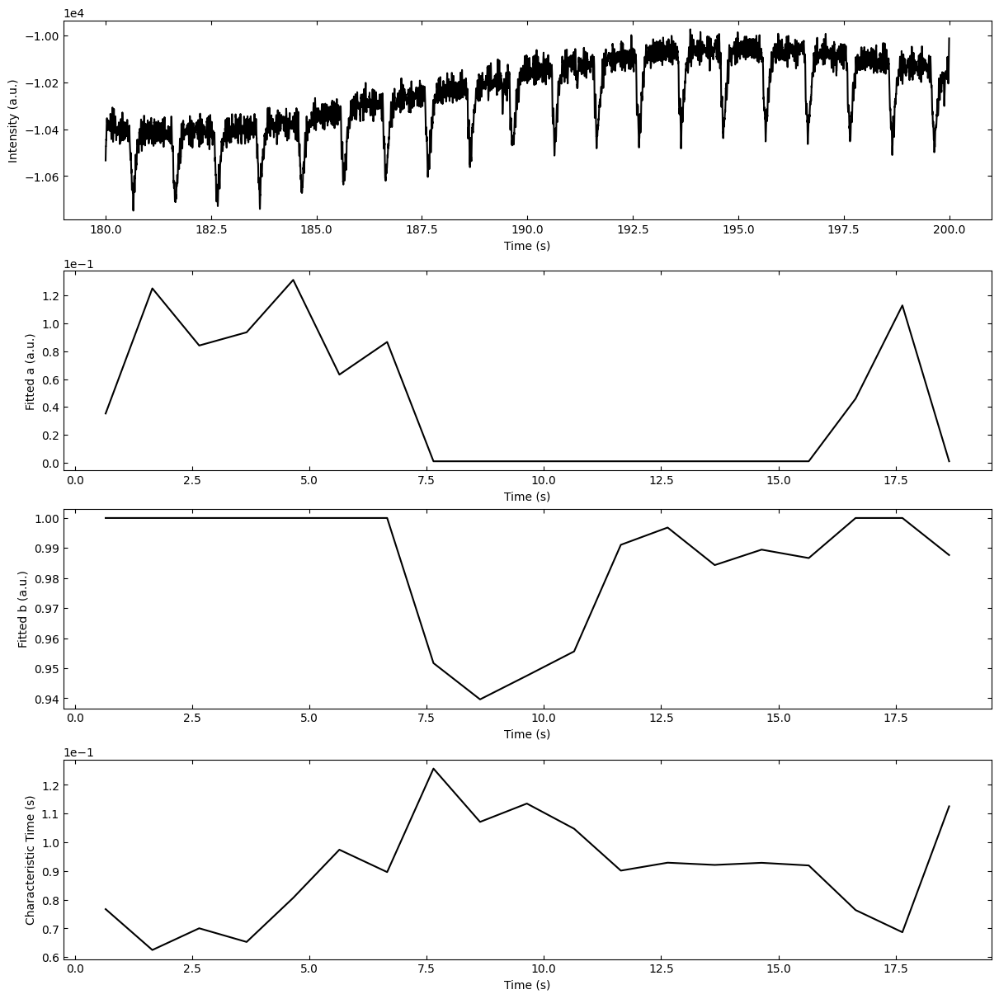

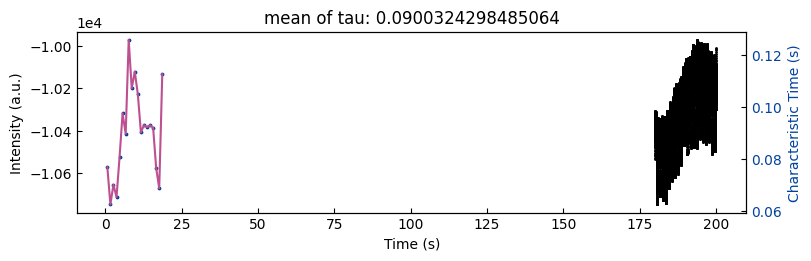

In [269]:
fit_settings={'step_size':101, 'prominence':10, 'savgol_window_order': (15, 3), 'pca_component': 3, 
              'I_diff': None, 'unify':False, 'bounds':[0.001, 1], 'p_init':[0.5, 0.4, 0.1]}
laser_freq = 1
camera_freq = 2000
viz_curves=True
viz_fittings=True
viz_ab=True

data = np.stack([sample_x, sample_y], 1)
data = select_range(data, 180, 200)
part_x, part_y = data[:,0], data[:,1]

denoised_part_y = denoise_fft(part_x, part_y, cutoff_freq=20, denoise_order=1, sample_frequency=2000)
# denoised_part_y = denoise_median(part_x, part_y, kernel_size=51)

data = np.stack([part_x, -denoised_part_y], 1)

parameters_all, x_list_all, info, tau = analyze_rheed_data(data, camera_freq, laser_freq, fit_settings, 
                                                           viz_curves, viz_fittings, viz_ab, n_std=3)

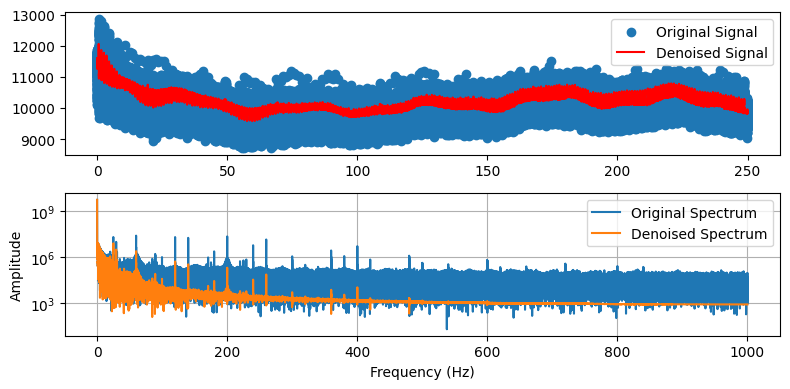

I:\RHEED_data\m3_learning\m3_learning\papers\2023_RHEED_PLD_SrTiO3 - UMich\../../src\m3_learning\RHEED\Viz.py:414: UserWarning: The figure layout has changed to tight
  plt.tight_layout(pad=-0.5, w_pad=-1, h_pad=-0.5)


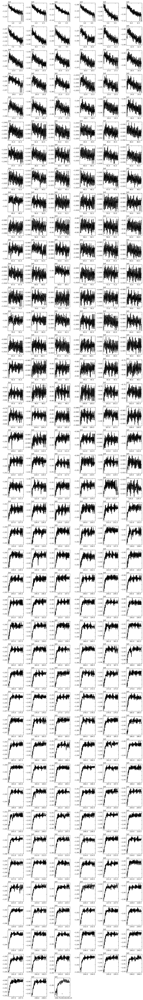

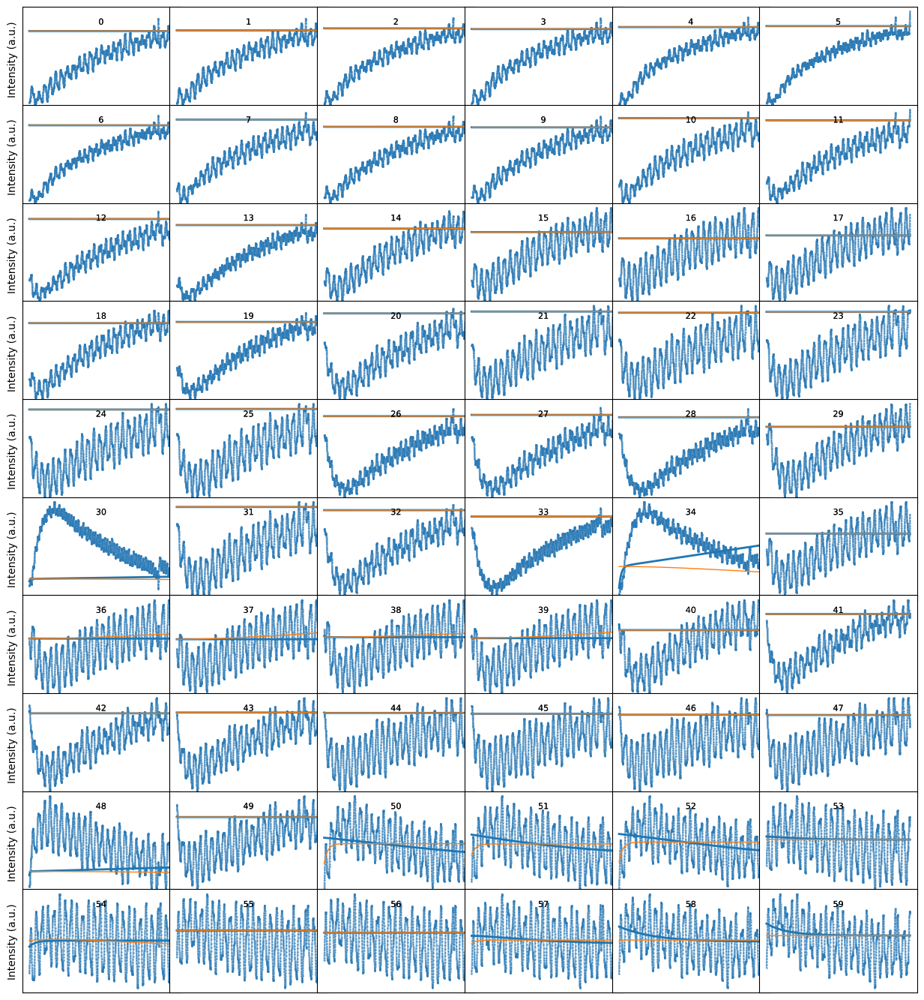

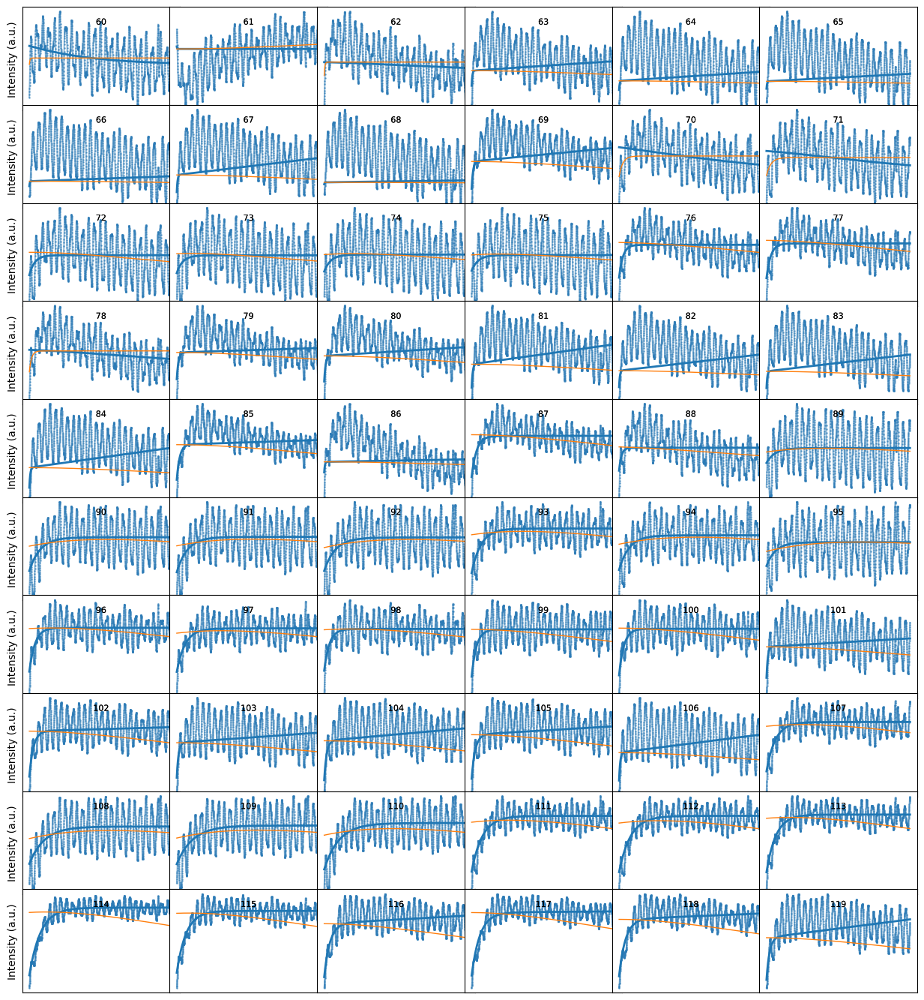

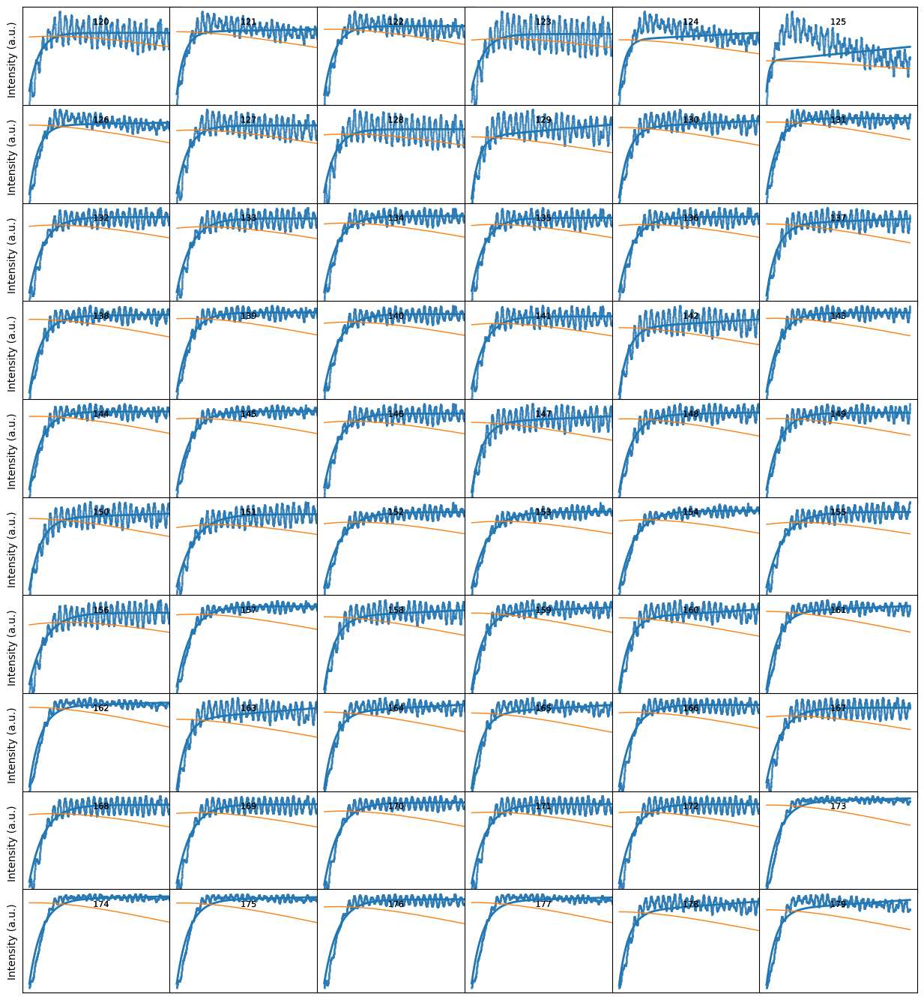

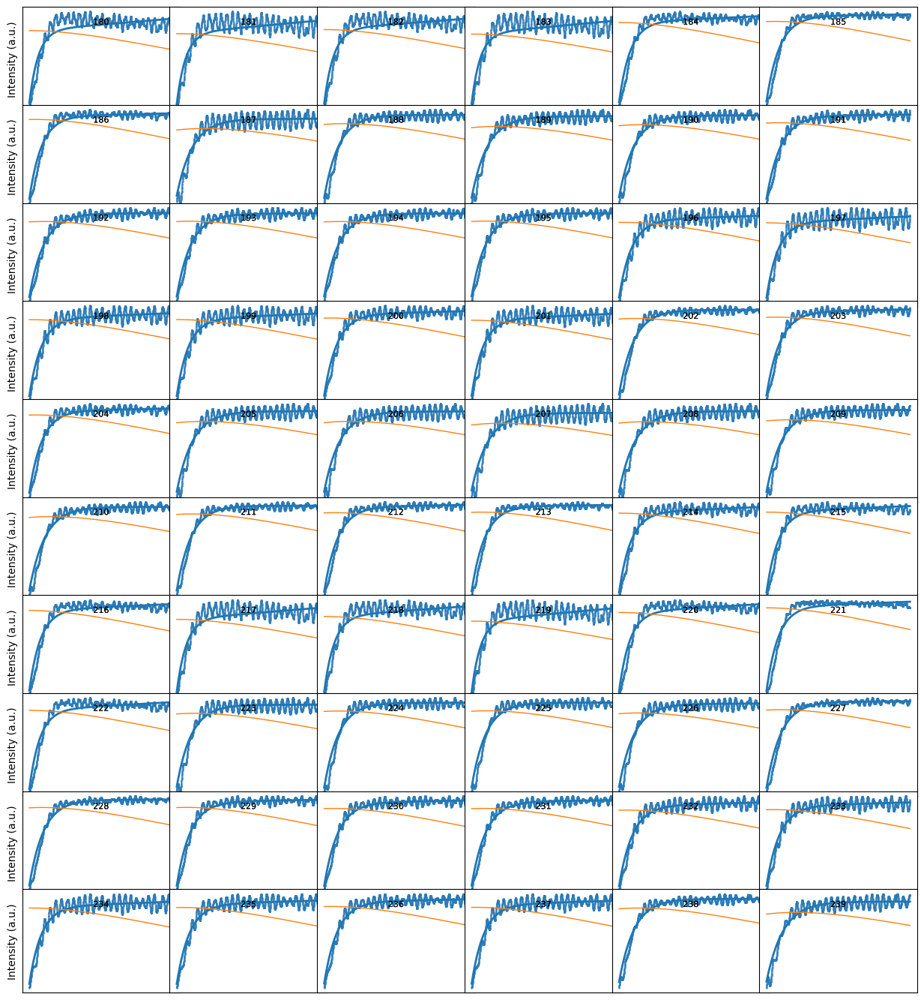

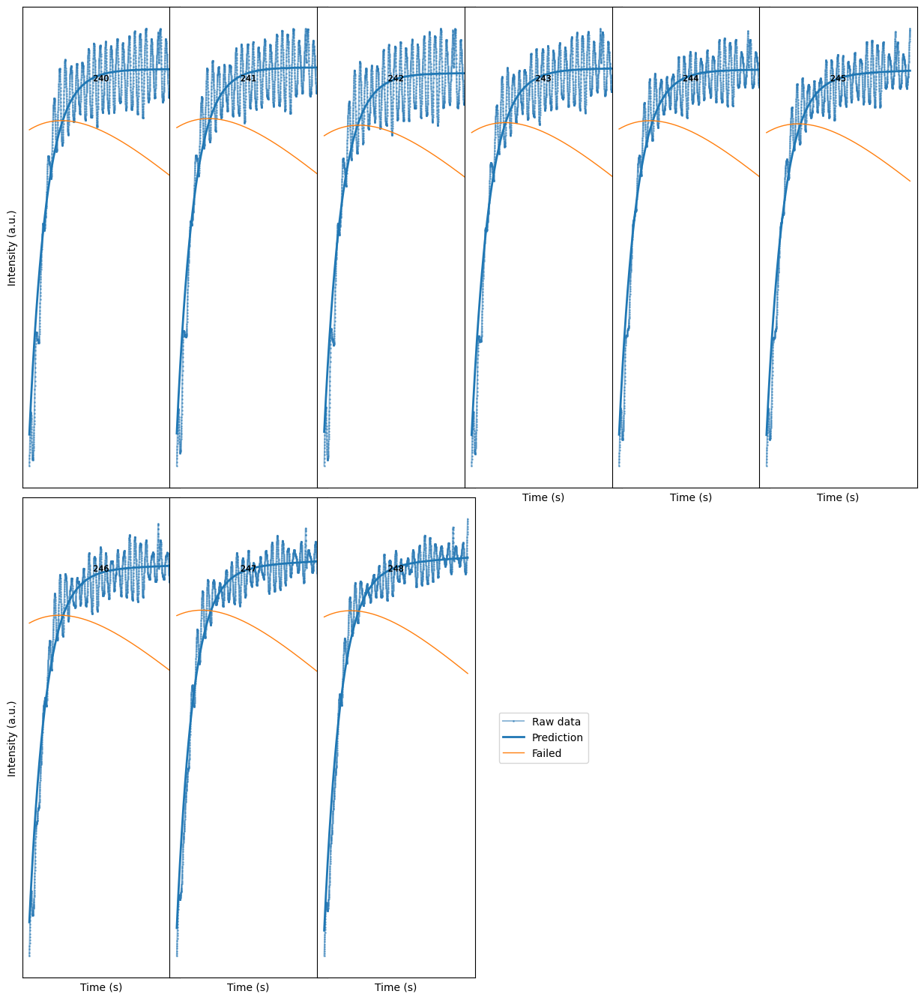

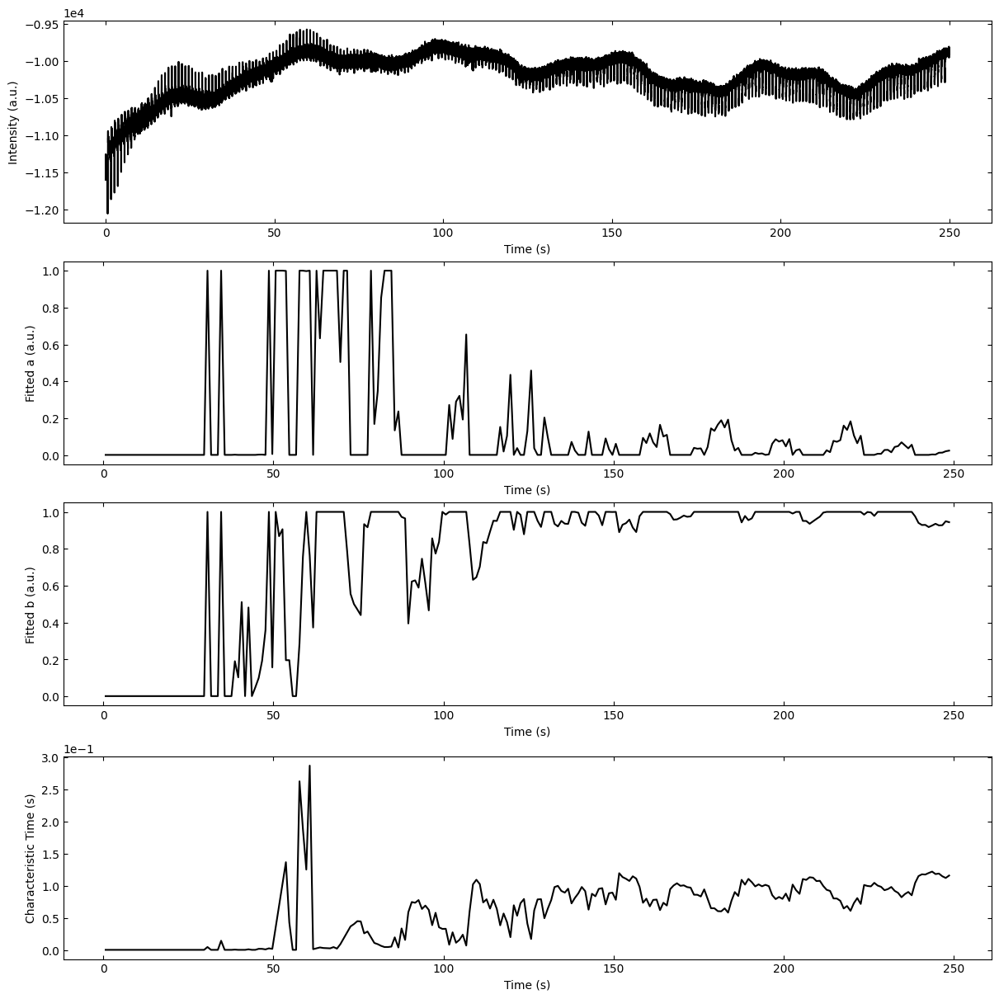

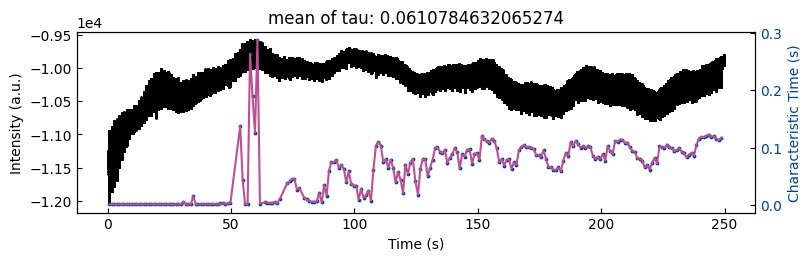

In [272]:
fit_settings={'step_size':101, 'prominence':10, 'savgol_window_order': (15, 3), 'pca_component': 3, 
              'I_diff': None, 'unify':False, 'bounds':[0.001, 1], 'p_init':[0.5, 0.4, 0.1]}
laser_freq = 1
camera_freq = 2000
viz_curves=True
viz_fittings=True
viz_ab=True

denoised_part_y = denoise_fft(sample_x, sample_y, cutoff_freq=20, denoise_order=1, sample_frequency=2000)
# denoised_part_y = denoise_median(part_x, part_y, kernel_size=51)
data = np.stack([sample_x, -denoised_part_y], 1)

parameters_all, x_list_all, info, tau = analyze_rheed_data(data, camera_freq, laser_freq, fit_settings, 
                                                           viz_curves, viz_fittings, viz_ab, n_std=3)

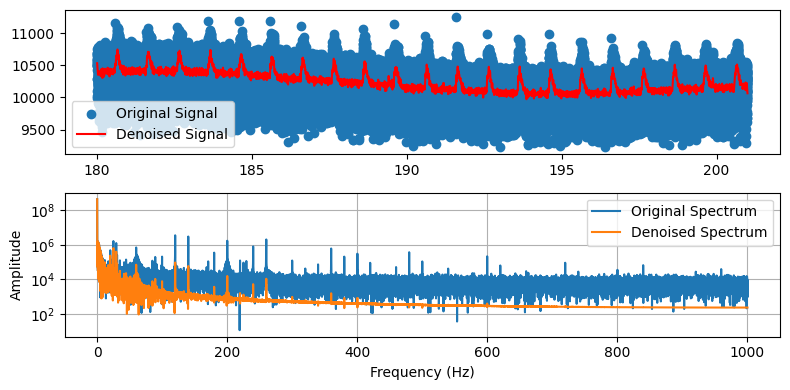

In [215]:
sample_x, sample_y = ds_para.load_curve(growth='temp250', spot='spot_1', metric='img_rec_sum', x_start=0)

data = np.stack([sample_x, sample_y], 1)
data = select_range(data, 180.0, 201)
part_x, part_y = data[:,0], data[:,1]
# denoised_part_y = denoise_median(part_x, part_y, kernel_size=11)
denoised_part_y = denoise_fft(part_x, part_y, cutoff_freq=20, denoise_order=1, sample_frequency=2000)

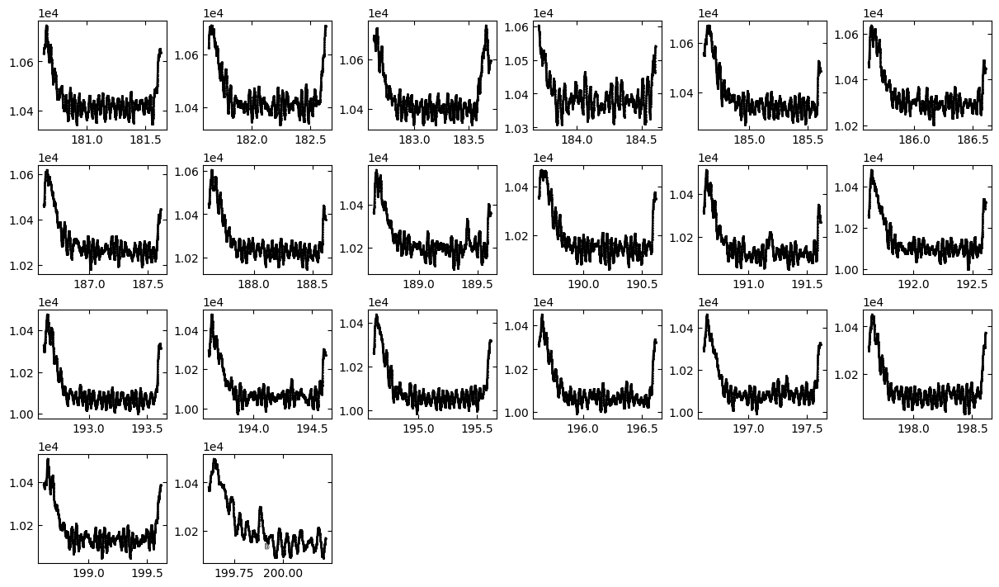

In [268]:
fit_settings={'step_size':101, 'prominence':1, 'savgol_window_order': (15, 3), 'pca_component': 3, 
              'I_diff': None, 'unify':False, 'bounds':[0.001, 1], 'p_init':[0.5, 0.4, 0.1]}
laser_freq = 1
camera_freq = 2000

step_size = fit_settings['step_size']
prominence = fit_settings['prominence']
x_peaks, xs, ys = detect_peaks(part_x, denoised_part_y, camera_freq=camera_freq, laser_freq=laser_freq, step_size=step_size, prominence=prominence)

xs_sample, ys_sample = xs[::1], ys[::1]
fig, axes = layout_fig(len(ys_sample), mod=6, figsize=(12,2*len(ys_sample)//6+1), layout='compressed')
Viz.show_grid_plots(axes, xs_sample, ys_sample, labels=None, xlabel=None, ylabel=None, ylim=None, legend=None, color=None)

In [223]:
from scipy import signal


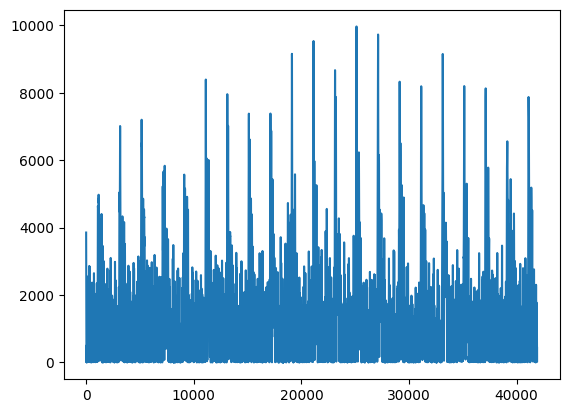

In [231]:
plt.plot(dary_step)

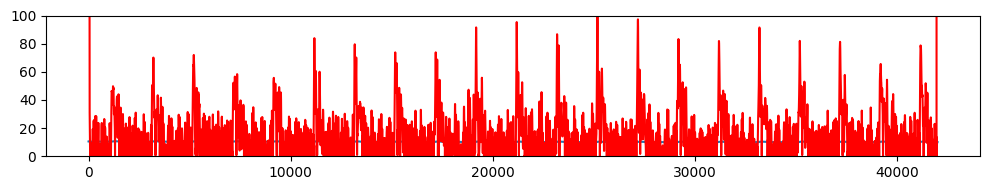

In [255]:
    plt.figure(figsize=(10,2))
    plt.plot(curve_y/1000)
    plt.plot(dary_step/100, color='r')    
    plt.ylim(0, 100)
    plt.tight_layout()
    plt.show()

In [243]:
dary_step

array([532941.91520463, 522249.57083797, 511565.03471112, ...,
       488163.41763626, 498089.58159356, 508005.98449368])

In [266]:
def reset_tails(ys, ratio=0.1):
    for i, y in enumerate(ys):
        num = int(len(y) * ratio)
        y[-num:] = y[-2*num:-num]
        ys[i] = y
    return ys

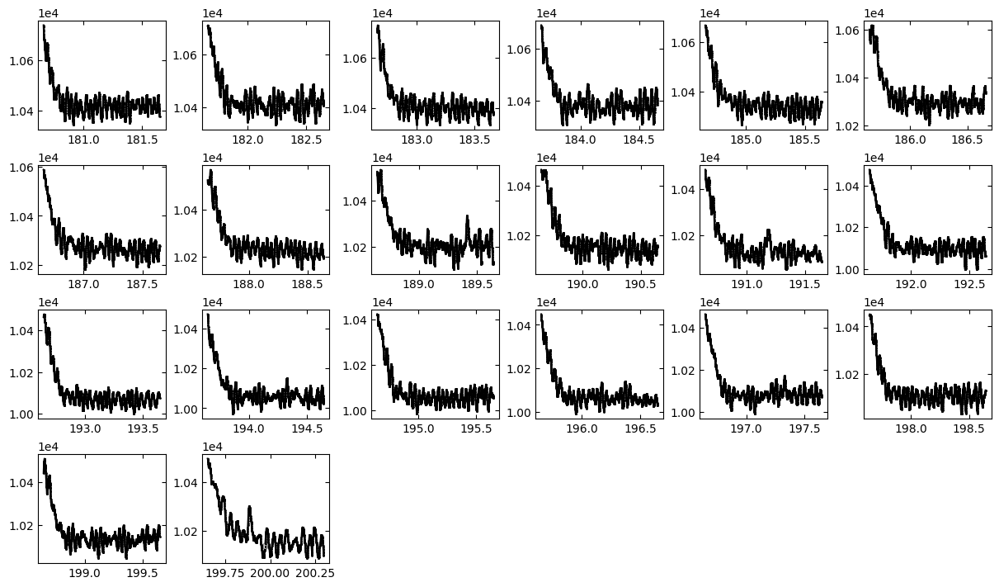

In [267]:
step_size = 101
prominence = 11
height = 100

# curve_x, curve_y = part_x, denoised_part_y

# dist = int(camera_freq/laser_freq*0.6)
# step = np.hstack((np.ones(step_size), -1*np.ones(step_size)))
# dary_step = np.convolve(curve_y, step, mode='full')
# dary_step = np.abs(dary_step)

# filtered_curve_y = dary_step/step_size
# x_peaks, properties = signal.find_peaks(filtered_curve_y, height=height, prominence=prominence, distance=dist)
# x_peaks = x_peaks[x_peaks>dist]
# x_peaks = x_peaks[x_peaks<len(curve_y)-dist]

# # get all partial curve 
# xs, ys = [], []
# for i in range(1, len(x_peaks)):
#     xs.append(list(curve_x[5+x_peaks[i-1]:x_peaks[i]]))
#     ys.append(list(curve_y[5+x_peaks[i-1]:x_peaks[i]]))
# x_peaks = x_peaks/camera_freq

x_peaks, xs, ys = detect_peaks(part_x, denoised_part_y, camera_freq=camera_freq, laser_freq=laser_freq, 
                               step_size=step_size, prominence=prominence)
ys = reset_tails(ys)
xs_sample, ys_sample = xs[::1], ys[::1]
fig, axes = layout_fig(len(ys_sample), mod=6, figsize=(12,2*len(ys_sample)//6+1), layout='compressed')
Viz.show_grid_plots(axes, xs_sample, ys_sample, labels=None, xlabel=None, ylabel=None, ylim=None, legend=None, color=None)

In [228]:
x_peaks+180

array([181.578 , 182.5775, 183.6495, 184.557 , 185.56  , 186.558 ,
       187.56  , 188.5615, 189.561 , 190.5645, 191.5635, 192.561 ,
       193.563 , 194.565 , 195.567 , 196.567 , 197.566 , 198.5625,
       199.5665])

In [ ]:
    if trim_first != 0:
        xs_trimed, ys_trimed = [], []
        for x, y in zip(xs, ys):
            ys_trimed.append(y[trim_first:])
            xs_trimed.append(np.linspace(x[0], x[-1], len(y[trim_first:])))
        xs, ys = xs_trimed, ys_trimed
    
    if viz_curves:
        xs_sample, ys_sample = xs[::1], ys[::1]
        fig, axes = layout_fig(len(ys_sample), mod=6, figsize=(12,2*len(ys_sample)//6+1), layout='compressed')
        Viz.show_grid_plots(axes, xs_sample, ys_sample, labels=None, xlabel=None, ylabel=None, ylim=None, legend=None, color=None)

In [ ]:
    x_end = 0
    length_list = []
    for xi in xs:
        length_list.append(len(xi))

    xs, ys = process_rheed_data(xs, ys, length=int(np.mean(length_list)), savgol_window_order=fit_settings['savgol_window_order'], 
                                pca_component=fit_settings['pca_component'])        

    parameters_all, x_list_all = [], []
    xs_all, ys_all, ys_fit_all, ys_nor_all, ys_nor_fit_all, ys_nor_fit_failed_all = [], [], [], [], [], []
    labels_all, losses_all =  [], []

    # fit exponential function
    parameters, info = fit_exp_function(xs, ys, growth_name='growth_1', fit_settings=fit_settings)        
    parameters_all.append(parameters)
    xs, ys, ys_fit, ys_nor, ys_nor_fit, ys_nor_fit_failed, labels, losses = info
    xs_all.append(xs)
    ys_all.append(ys)
    ys_fit_all+=ys_fit
    ys_nor_all+=ys_nor
    ys_nor_fit_all+=ys_nor_fit
    ys_nor_fit_failed_all+=ys_nor_fit_failed
    labels_all += labels
    losses_all += losses

    x_list = x_peaks[:-1] + x_end
    x_end = round(x_end + (len(sample_x)+0)/30, 2)
    x_list_all.append(x_list)
        
    parameters_all = np.concatenate(parameters_all, 0)
    x_list_all = np.concatenate(x_list_all)[:len(parameters_all)]
    xs_all = np.concatenate(xs_all)
    ys_all = np.concatenate(ys_all)
    ys_nor_all = np.array(ys_nor_all)
    ys_nor_fit_all = np.array(ys_nor_fit_all)
    losses_all = np.array(losses_all)
    ys_nor_fit_all_failed = np.array(ys_nor_fit_failed_all)

I:\RHEED_data\m3_learning\m3_learning\papers\2023_RHEED_PLD_SrTiO3 - UMich\../../src\m3_learning\RHEED\Viz.py:414: UserWarning: The figure layout has changed to tight
  plt.tight_layout(pad=-0.5, w_pad=-1, h_pad=-0.5)


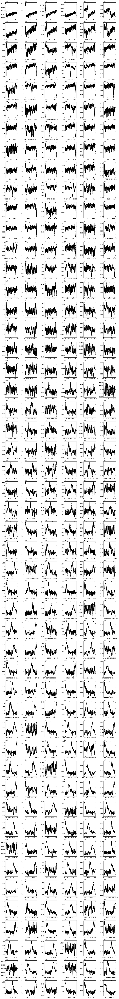

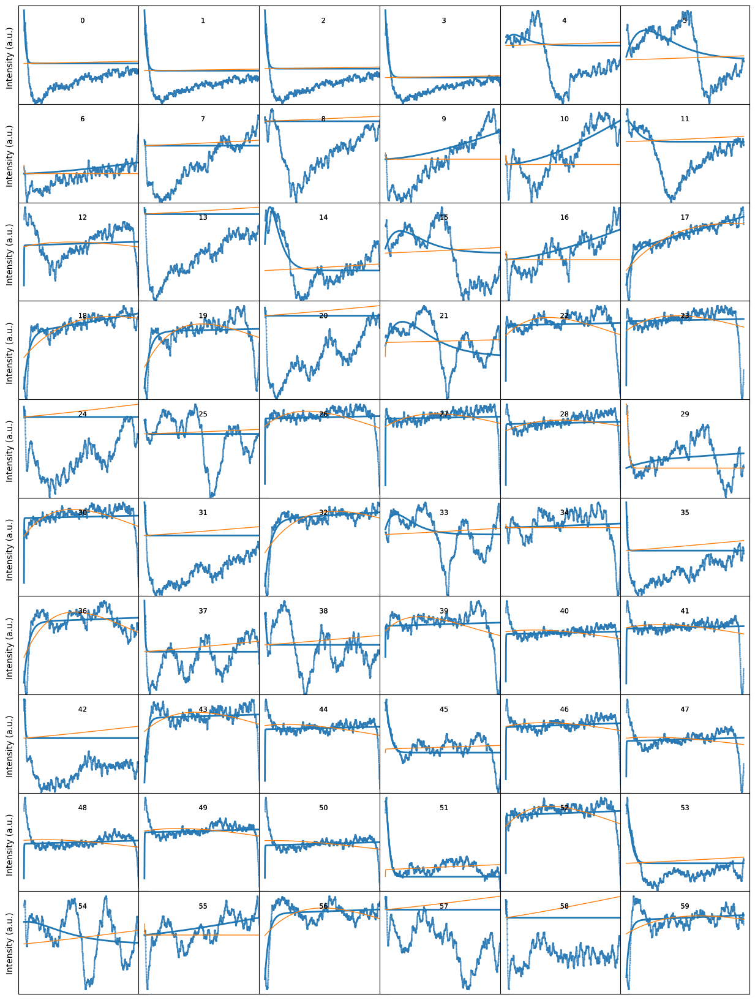

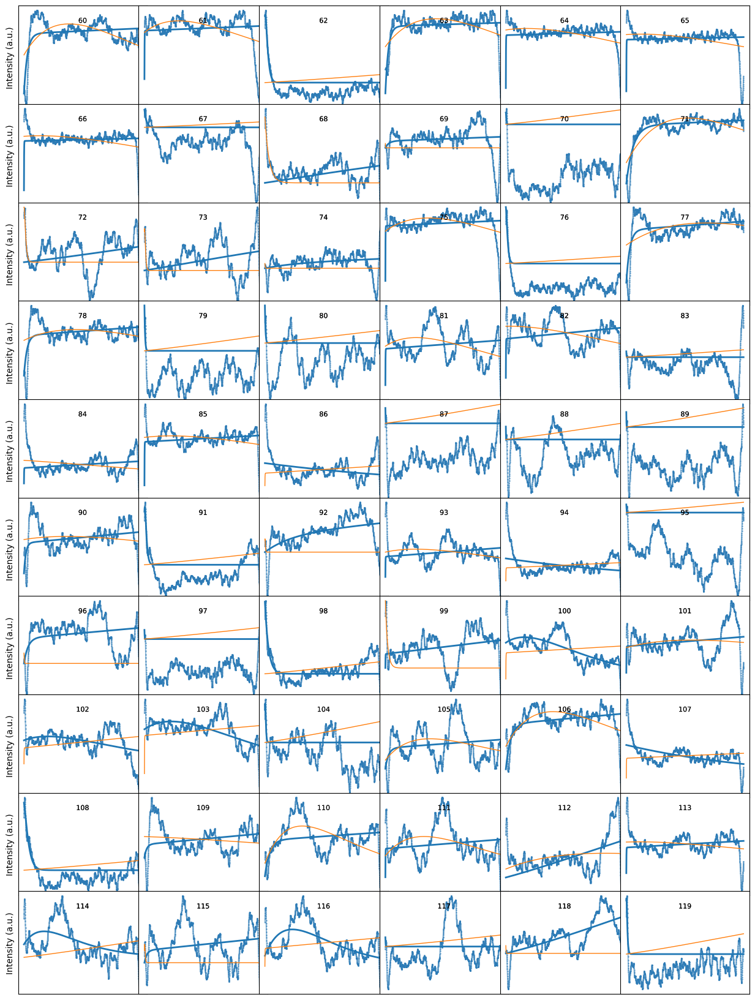

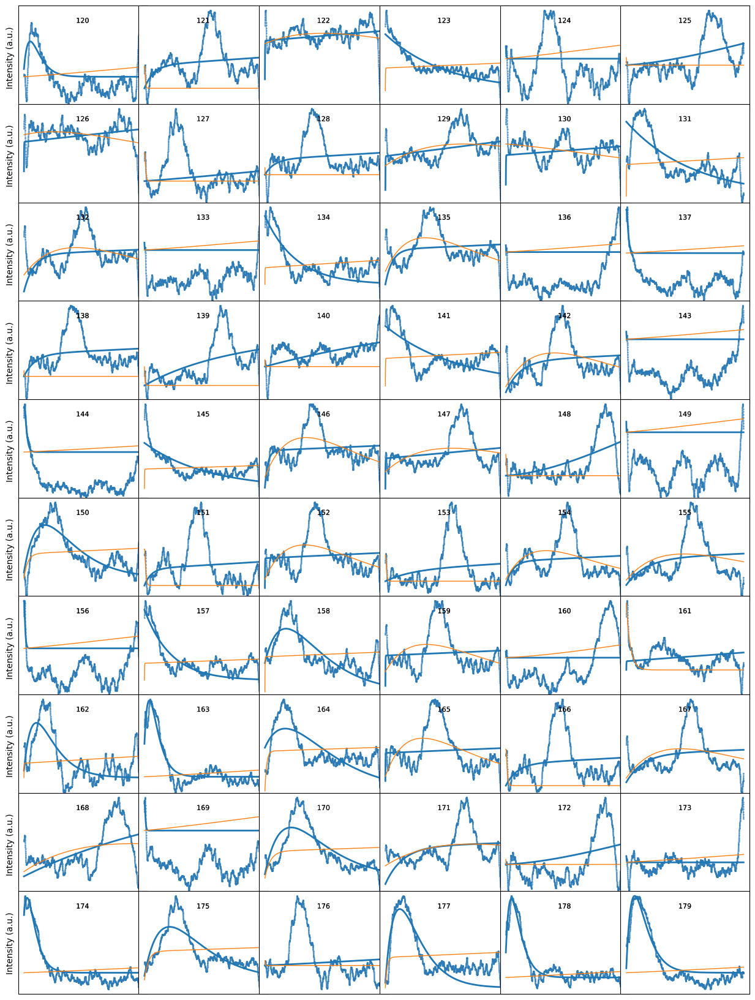

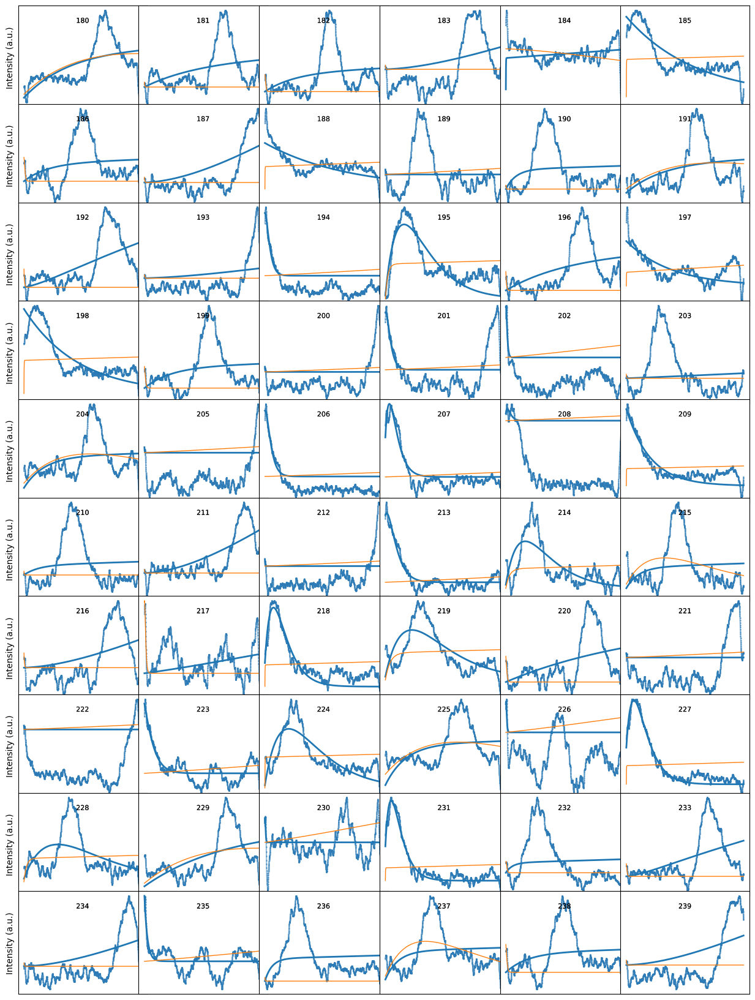

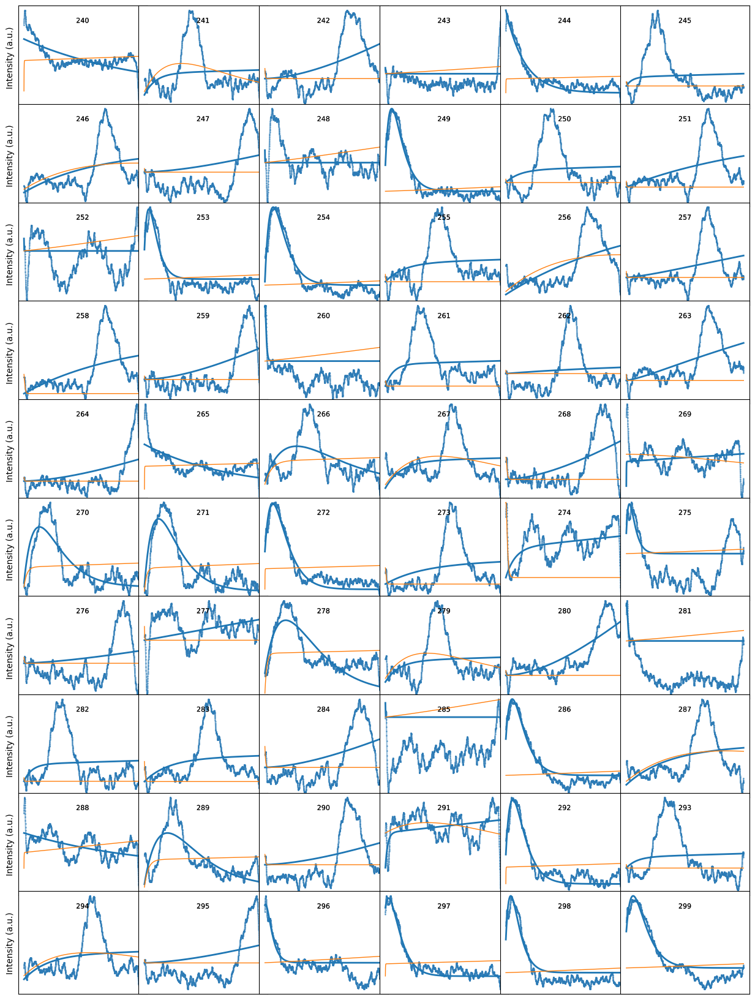

IndexError: index -2 is out of bounds for axis 0 with size 1

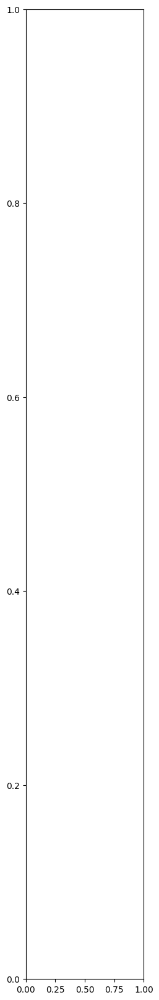

In [134]:
detect_param={'step_size':3, 'prominence':10}
laser_freq = 1
camera_freq = 2000
viz_curves=True
viz_fittings=True
viz_ab=True

data = np.stack([sample_x, denoised_sample_y], 1)
parameters_all, x_list_all, info, tau = analyze_rheed_data(data, camera_freq, laser_freq, detect_param, viz_curves, viz_fittings, viz_ab, n_std=3)

I:\RHEED_data\m3_learning\m3_learning\papers\2023_RHEED_PLD_SrTiO3 - UMich\../../src\m3_learning\RHEED\Viz.py:414: UserWarning: The figure layout has changed to tight
  plt.tight_layout(pad=-0.5, w_pad=-1, h_pad=-0.5)


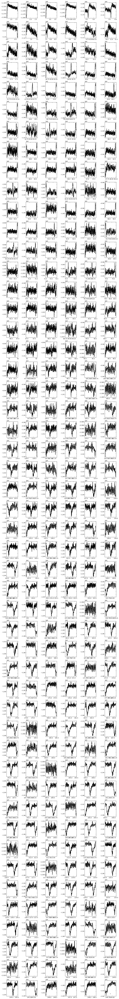

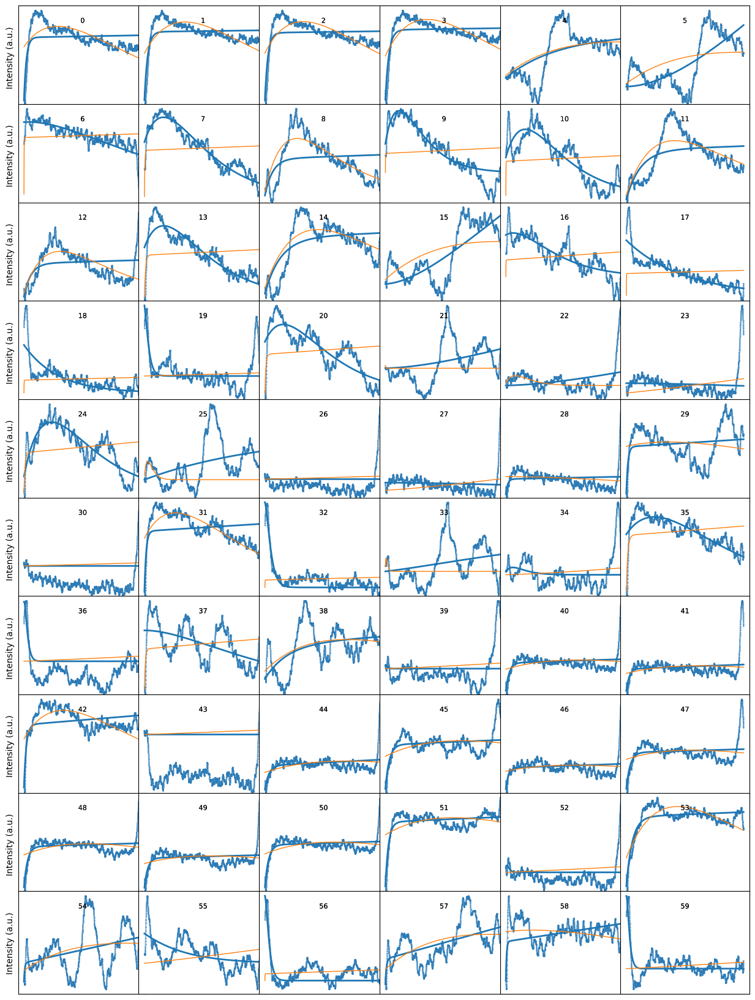

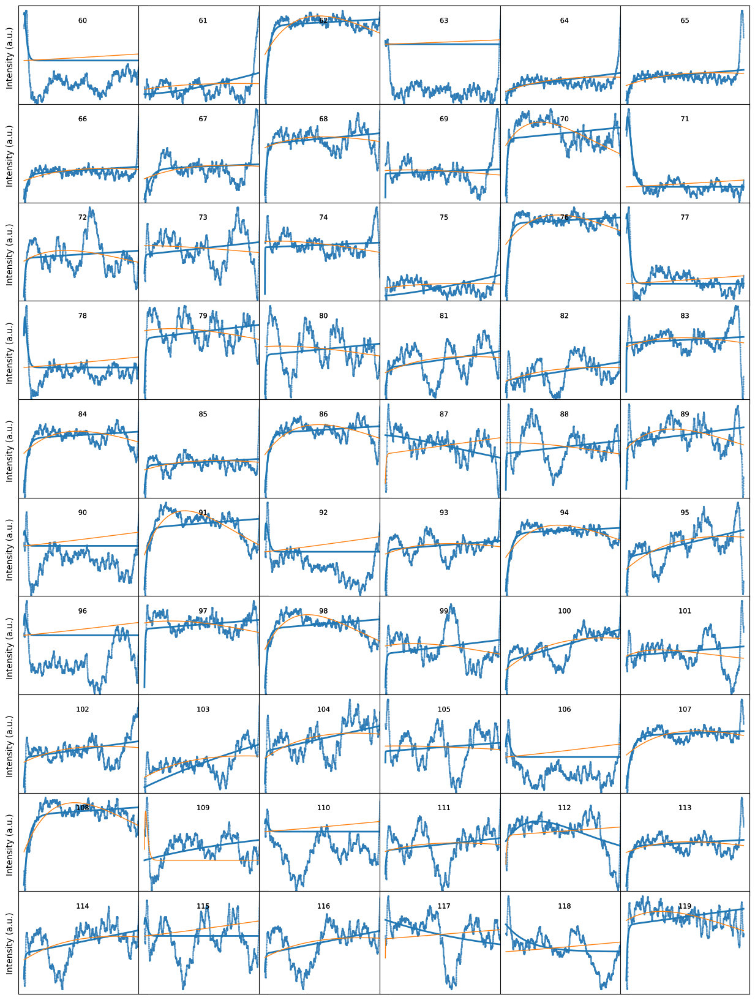

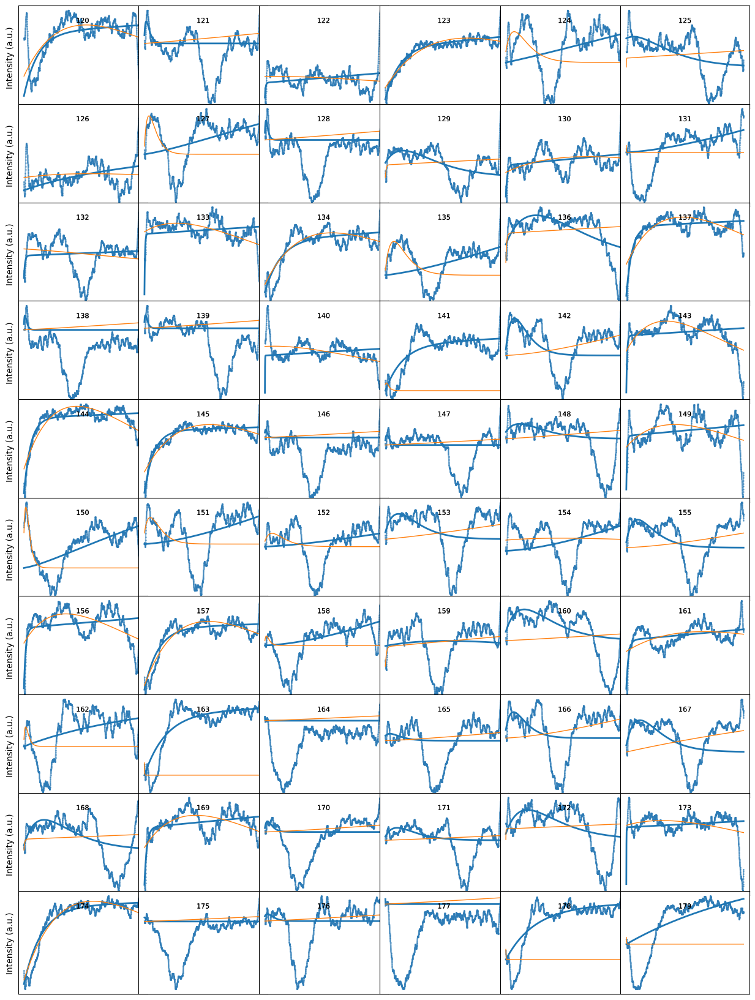

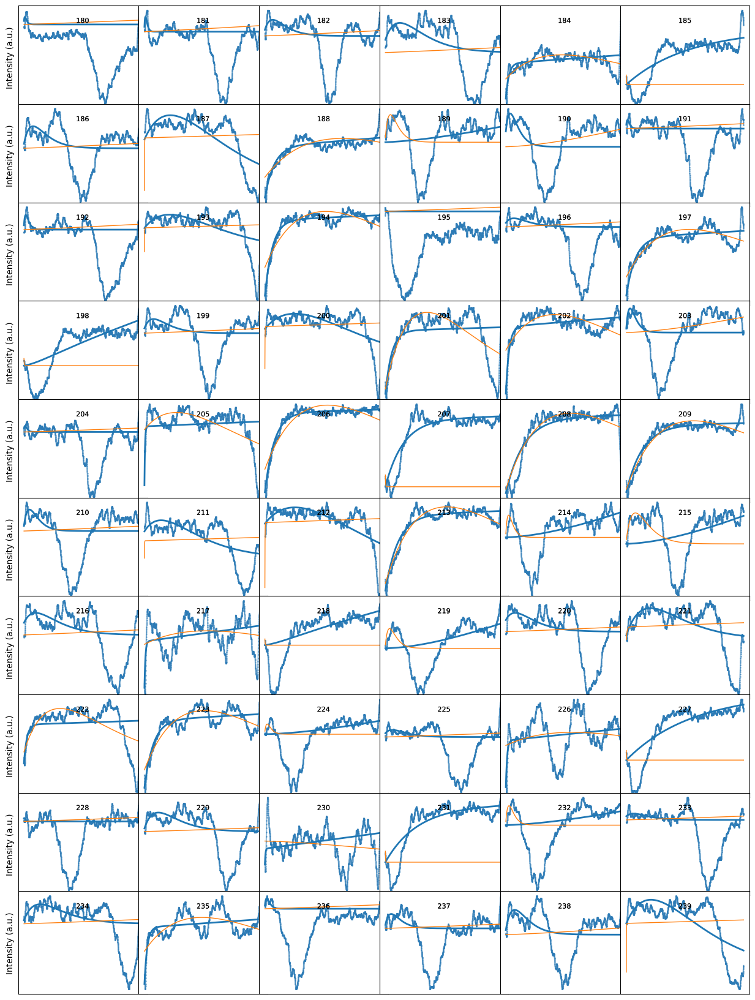

KeyboardInterrupt: 

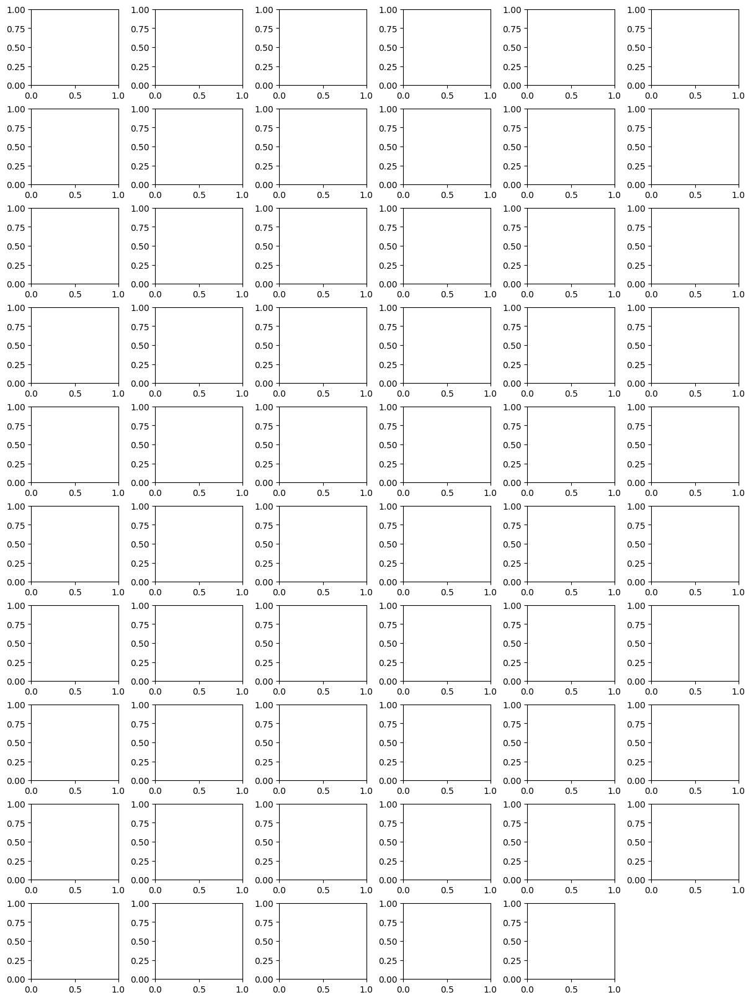

In [135]:
detect_param={'step_size':3, 'prominence':10}
laser_freq = 1
camera_freq = 2000
viz_curves=True
viz_fittings=True
viz_ab=True

data = np.stack([sample_x, -denoised_sample_y], 1)
parameters_all, x_list_all, info, tau = analyze_rheed_data(data, camera_freq, laser_freq, detect_param, viz_curves, viz_fittings, viz_ab, n_std=3)

In [15]:
detect_param={'step_size':3, 'prominence':10}
laser_freq = 1
camera_freq = 2000
viz_curves=True
viz_fittings=True
viz_ab=True

In [17]:
for m in ["img_mean", "img_sum", "img_max", "img_rec_sum", "img_rec_max", "img_rec_mean", 
          "height", "x", "y", "width_x", "width_y"]:
    x, y = D1_para.load_curve(growth='temp300', spot='spot_1', metric=m, x_start=0)
    sample_x, sample_y = x[10200:12500], y[10200:12500]
    print(m)
    plt.figure(figsize=(12,4))
    plt.scatter(sample_x, sample_y)
    plt.show()
    
    data = np.stack([x, y], axis=1)
    parameters_all, x_list_all, info, tau = analyze_rheed_data(data, camera_freq, laser_freq, detect_param, viz_curves, viz_fittings, viz_ab, n_std=3)

OSError: [Errno 0] Unable to open file (unable to lock file, errno = 0, error message = 'No error', Win32 GetLastError() = 33)

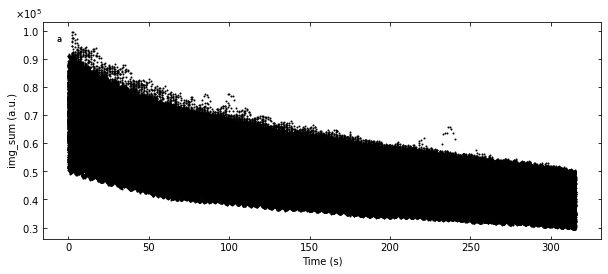

Gaussian fitted parameters in time: Fig. a: sum of original image, b: sum of reconstructed image, c: spot center in spot x coordinate, d: spot center in y coordinate, e: spot width in x coordinate, f: spot width in y coordinate.


In [17]:
growth_list = ['temp300']
D1_para.viz_RHEED_parameter_trend(growth_list, spot='spot_2', metric_list=['img_sum'], 
                                  head_tail=(100,300), interval=200, figsize=(10,4))

In [20]:
spot = 'spot_2'
metric = 'img_sum'
camera_freq = 2000
fit_settings = {'savgol_window_order': (50, 3), 'pca_component': 10, 'I_diff': 15000, 
                'unify':False, 'bounds':[0.001, 1], 'p_init':[0.1, 0.4, 0.1]}

growth_dict = {'temp300':1}
x_all, y_all = D1_para.load_multiple_curves(growth_dict.keys(), spot, metric, x_start=0, interval=0)

parameters_all, x_coor_all, info = analyze_curves(D1_para, growth_dict, spot, metric, interval=0, fit_settings=fit_settings)
[xs_all, ys_all, ys_fit_all, ys_nor_all, ys_nor_fit_all, ys_nor_fit_failed_all, labels_all, losses_all] = info

# define two color regime
x_y1 = x_coor_all[losses_all[:,0]>losses_all[:,1]]
x_y2 = x_coor_all[losses_all[:,0]<losses_all[:,1]]
color_array = Viz.two_color_array(x_coor_all, x_y1, x_y2, bgc1, bgc2, transparency=0.5)
color_array = np.concatenate([np.expand_dims(x_coor_all, 1), color_array], axis=1)
Viz.plot_fit_details(xs_all, ys_nor_all, ys_nor_fit_all, ys_nor_fit_failed_all, index_list=range(len(x_all)))

RuntimeError: Optimal parameters not found: The maximum number of function evaluations is exceeded.

In [ ]:
fig, axes = layout_fig(4, 1, figsize=(6.5, 2*4))
Viz.plot_curve(axes[0], x_all, y_all, plot_type='lineplot', xlabel='Time (s)', ylabel='Intensity (a.u.)', xlim=(-2, 130), yaxis_style='sci')
Viz.plot_curve(axes[1], x_coor_all, parameters_all[:,0], plot_type='lineplot', xlabel='Time (s)', ylabel='Fitted a (a.u.)', xlim=(-2, 130))
Viz.plot_curve(axes[2], x_coor_all, parameters_all[:,1], plot_type='lineplot', xlabel='Time (s)', ylabel='Fitted b (a.u.)', xlim=(-2, 130))
Viz.plot_curve(axes[3], x_coor_all, parameters_all[:,2], plot_type='lineplot', xlabel='Time (s)', ylabel='Characteristic Time (s)', xlim=(-2, 130))
plt.show()

In [ ]:
fig, ax1 = plt.subplots(1, 1, figsize=(6, 2.5), layout='compressed')
ax1.scatter(sample_x, sample_y, color='k', s=1)
Viz.set_labels(ax1, xlabel='Time (s)', ylabel='Intensity (a.u.)', ticks_both_sides=False)

# n_std = 3
tau = parameters_all[:,2]
x_clean = x_list_all[np.where(tau < np.mean(tau) + n_std*np.std(tau))[0]]
tau = tau[np.where(tau < np.mean(tau) + n_std*np.std(tau))[0]]

x_clean = x_clean[np.where(tau > np.mean(tau) - n_std*np.std(tau))[0]]
tau = tau[np.where(tau > np.mean(tau) - n_std*np.std(tau))[0]]
# print('mean of tau:', np.mean(tau))

ax2 = ax1.twinx()
ax2.scatter(x_list_all, parameters_all[:,2], color=seq_colors[0], s=3)
ax2.plot(x_clean,  tau, color='#bc5090', markersize=3)
Viz.set_labels(ax2, ylabel='Characteristic Time (s)', yaxis_style='lineplot', ylim=(-0.05, 0.8), ticks_both_sides=False)
ax2.tick_params(axis="y", color='k', labelcolor=seq_colors[0])
ax2.set_ylabel('Characteristic Time (s)', color=seq_colors[0])
plt.title('mean of tau: '+str(np.mean(tau)))
plt.show()

### 2.2 J14-350C

img_sum


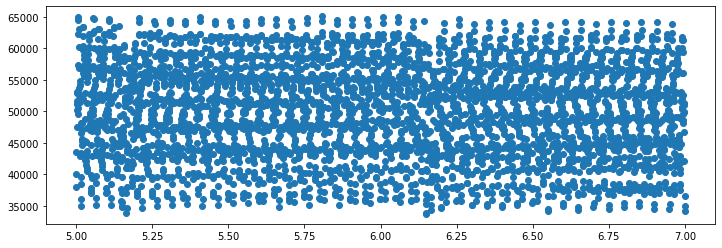

img_max


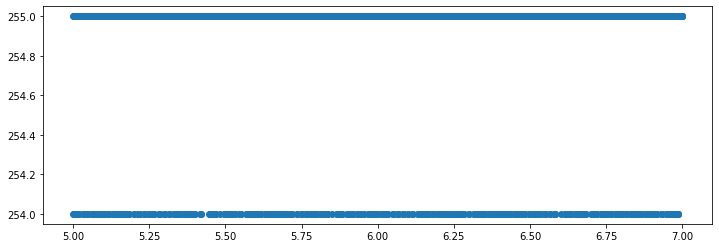

img_mean


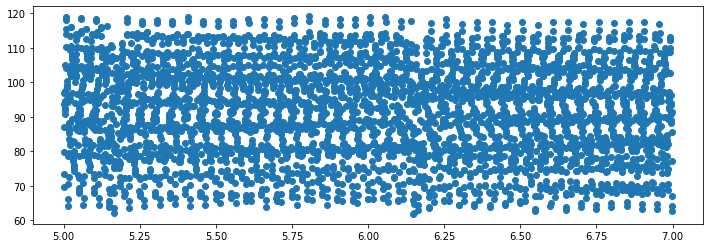

img_rec_sum


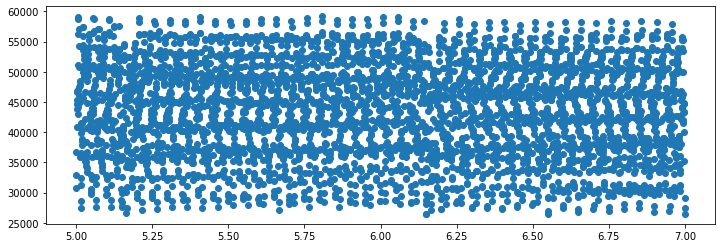

img_rec_max


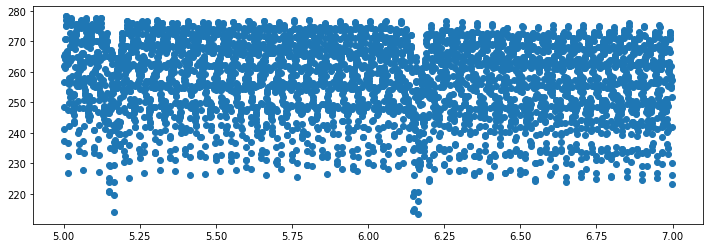

img_rec_mean


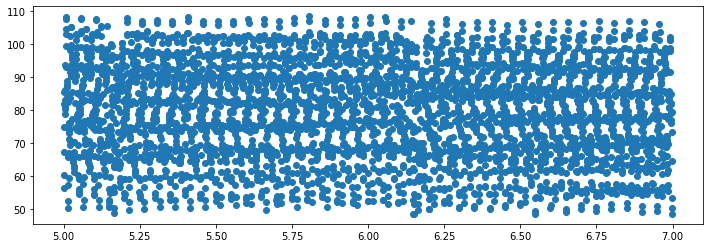

height


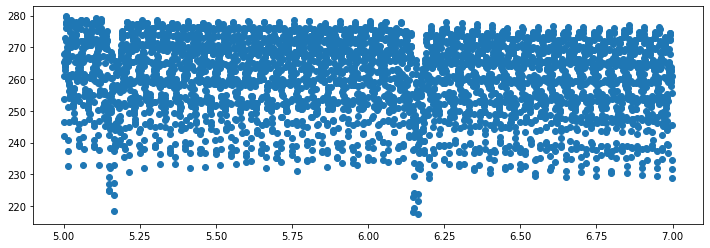

x


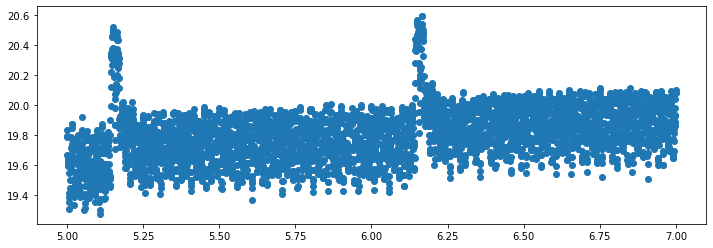

y


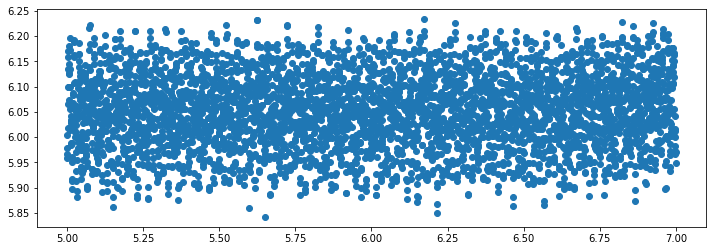

width_x


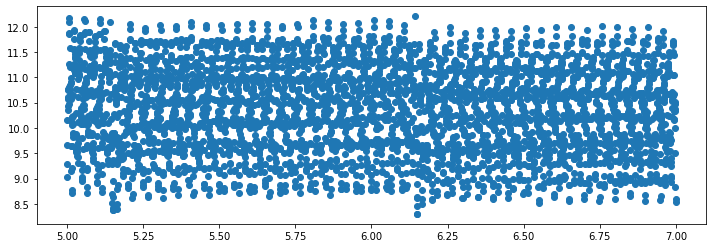

width_y


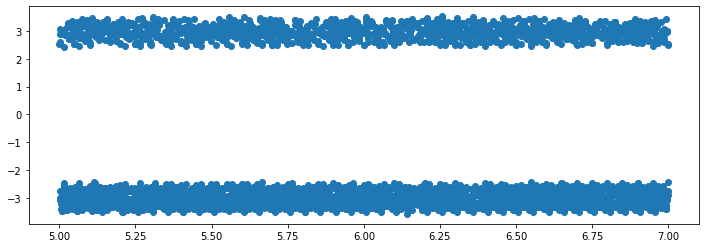

In [46]:
for m in ["img_sum", "img_max", "img_mean", "img_rec_sum", "img_rec_max", "img_rec_mean", 
          "height", "x", "y", "width_x", "width_y"]:
    x, y = D1_para.load_curve(growth='temp350', spot='spot_2', metric=m, x_start=0)
    print(m)
    plt.figure(figsize=(12,4))
    plt.scatter(x[10000:14000], y[10000:14000])
    plt.show()